In [925]:
from PIL import Image
import numpy as np 
import os 


import numpy as np
import matplotlib.pyplot as pl
import torch
import ot
import ot.plot

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Enable interactive mode
%matplotlib ipympl
os.environ["CUDA_VISIBLE_DEVICES"] = "1" # has not effect

import sys
sys.path.append("../")
device="cuda"
from tqdm import tqdm_notebook as tqdm

from gaussian_renderer import render, network_gui
from arguments import ModelParams, PipelineParams, OptimizationParams
import argparse
from scene import Scene, GaussianModel
from random import randint
from argparse import ArgumentParser, Namespace

In [926]:
saving_steps = [1, 100, 300, 1_000, 3_000, 7_000, 10_000, 15_000, 20_000, 30_000]
parser = ArgumentParser(description="Training script parameters")
lp = ModelParams(parser)
op = OptimizationParams(parser)
pp = PipelineParams(parser)
parser.add_argument('--ip', type=str, default="127.0.0.1")
parser.add_argument('--port', type=int, default=6009)
parser.add_argument('--debug_from', type=int, default=-1)
parser.add_argument('--detect_anomaly', action='store_true', default=False)
parser.add_argument("--test_iterations", nargs="+", type=int, default=saving_steps)
parser.add_argument("--save_iterations", nargs="+", type=int, default=saving_steps)
parser.add_argument("--quiet", action="store_true")
parser.add_argument("--checkpoint_iterations", nargs="+", type=int, default=saving_steps)# default=[])
parser.add_argument("--start_checkpoint", type=str, default = None)
args = parser.parse_args(("-s /home/dimakot55/data/nerf_synthetic/hotdog/ "+\
                         "--model_path /home/dimakot55/workspace/gaussian-splatting/notebooks/GT_lego_cluster2_test_notebook14/").split())#sys.argv[1:])
#args.save_iterations.append(args.iterations)
dataset=lp.extract(args)
pipe=pp.extract(args)
opt=op.extract(args)
os.makedirs(args.model_path, exist_ok=True)

In [927]:
os.makedirs(args.model_path, exist_ok=True)
content_gaussians = GaussianModel(3)
content_scene = Scene(dataset, content_gaussians, shuffle=True)
content_gaussians.training_setup(opt)

Found transforms_train.json file, assuming Blender data set!
Reading Training Transforms
Reading Test Transforms
Loading Training Cameras
Loading Test Cameras
Number of points at initialisation :  100000


In [928]:
! ls /home/dimakot55/output_data/gs_fitted/gs_fitted/

GT_brickwall	  GT_ficus_spheres   GT_lego_spheres	   GT_ship_spheres
GT_chair_spheres  GT_gazon	     GT_materials_spheres
GT_drums_spheres  GT_hotdog_spheres  GT_mic_spheres


In [1057]:

# content_gaussians.restore(torch.load("/home/dimakot55/output_data/gs_fitted/gs_fitted/GT_hotdog_spheres/chkpnt30000.pth")[0], opt)
# content_gaussians.restore(torch.load("/home/dimakot55/output_data/gs_fitted/gs_fitted/GT_hotdog/chkpnt30000.pth")[0], opt)

content_gaussians.restore(torch.load("/home/dimakot55/output_data/gs_my/gs/GT_hotdog/chkpnt30000.pth")[0], opt)
# content_gaussians.restore(torch.load("/home/dimakot55/output_data/gs_fitted/gs_fitted/GT_chair_spheres/chkpnt30000.pth")[0], opt)

In [1058]:
content_gaussians._features_dc

Parameter containing:
tensor([[[ 0.1129, -0.1758, -0.1624]],

        [[ 0.8529, -0.0241, -0.9536]],

        [[ 0.2561, -0.1540, -0.6084]],

        ...,

        [[ 0.3547,  0.1921, -0.2945]],

        [[ 0.4366,  0.3284,  0.0153]],

        [[ 1.3543,  1.1201,  0.4569]]], device='cuda:0', requires_grad=True)

In [1059]:
# Turn color into coordinates. We will need that to optimize 
# Remove view dependent effects and make all the gaussians opaque. 
# That helps with getting a better mesh
content_gaussians._opacity.data +=  1e6
content_gaussians_features_ds_original = content_gaussians._features_dc.detach().clone()
content_gaussians._features_dc.data = content_gaussians._xyz.data.clone().detach().unsqueeze(1)
content_gaussians._features_rest.data = content_gaussians._features_rest.data * 0.
# content_gaussians._scaling.data *=  .98


In [1054]:
# For a chair 
content_gaussians._scaling.data *=  .7


In [1062]:

bg_color = [1, 1, 1] if dataset.white_background else [0, 0, 0]
background = torch.tensor(bg_color, dtype=torch.float32, device=device)
viewpoint_stack = content_scene.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))



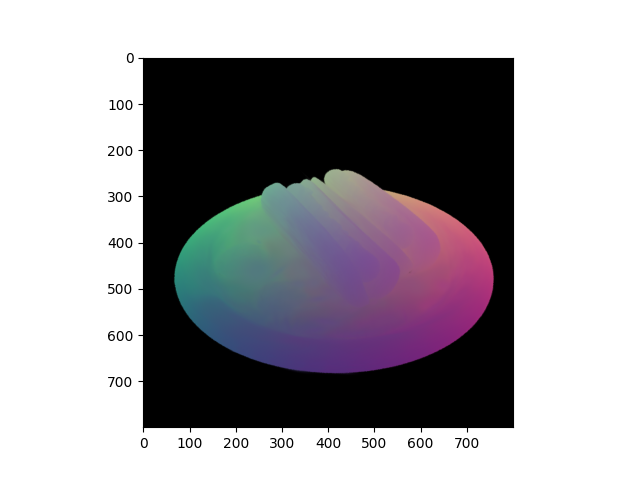

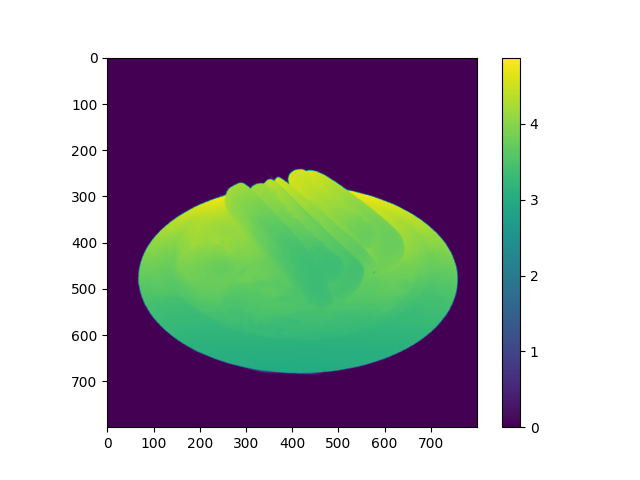

In [1063]:

render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()


depth_np = depth_cont.detach().cpu().numpy()

plt.figure()
plt.imshow(depth_np)
plt.colorbar()
plt.show()


In [935]:

def obtain_surface_pc(viewpoint_stack, gaussians, pipe, background, num_viewpoints=40, pc_size=20000):
    import numpy as np
    import skimage.measure, skimage.morphology
    import scipy

    # 1. Render from different viewpoints and extract points
    all_points = []
    for iter in range(min(num_viewpoints, len(viewpoint_stack))):
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
        render_pkg_cont = render(viewpoint_cam, gaussians, pipe, background)
        image = render_pkg_cont["render"]
        image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
        image_maxpool = skimage.measure.block_reduce(image_rgb, (3,3,1), np.max)
        mask = scipy.ndimage.binary_erosion(np.max(image_maxpool, axis=-1) > 0.1, structure=None, iterations=5)
        image_clean = image_maxpool * np.expand_dims(mask, axis=-1)
        all_points += list(image_clean[np.min(image_clean, axis=-1)>0.1])
    
    
    # 2. Subsample the points 
    all_points = np.array(all_points)
    all_points_idcs = np.random.choice(range(len(all_points)), size=pc_size, replace=False) 
    all_points = all_points[all_points_idcs]

    # 3. Remove poitns that are too far away from all other points.
    # Compute all pairwise distances between points
    from scipy.spatial import distance
    k=10
    pairwise_distances = distance.cdist(all_points, all_points, 'euclidean')
    # Use np.partition to find the k-th smallest distances for each row
    kth_nearest_indices = np.argpartition(pairwise_distances, k, axis=1)[:, :k]
    kth_nearest_distances = np.take_along_axis(pairwise_distances, kth_nearest_indices, axis=1)
    q_outliers = np.quantile(np.max(kth_nearest_distances, axis=-1), 0.99)
    idcs = np.where(np.max(kth_nearest_distances, axis=-1) < q_outliers)[0]
    all_points = all_points[idcs]
    return all_points
        

In [936]:

content_surface_pc = obtain_surface_pc(viewpoint_stack=viewpoint_stack, 
                               gaussians=content_gaussians, 
                               pipe=pipe, 
                               background=background,
                               num_viewpoints=40)
# Rescale back. This can be a very wrong way to do that. Check better the rasterization code for 


In [937]:
content_surface_pc_orig = np.array(content_surface_pc)
coords = content_gaussians._xyz.data.detach().cpu().numpy()

In [938]:
content_surface_pc = (content_surface_pc - np.min(content_surface_pc)) / (np.max(content_surface_pc)  - np.min(content_surface_pc))
content_surface_pc = content_surface_pc * (np.max(coords)  - np.min(coords)) + np.min(coords)

In [939]:
np.min(coords, axis=0), \
np.max(coords, axis=0), \
np.min(content_surface_pc, axis=0), \
np.max(content_surface_pc, axis=0)

(array([-1.1968784 , -1.2858015 , -0.32095665], dtype=float32),
 array([1.1970536, 1.1088687, 0.3142582], dtype=float32),
 array([-1.194461 , -1.2858015, -1.2706244], dtype=float32),
 array([1.1970536 , 1.1084977 , 0.30359113], dtype=float32))

In [940]:
np.min(coords, axis=0), \
np.max(coords, axis=0), \
np.min(content_surface_pc, axis=0), \
np.max(content_surface_pc, axis=0)

(array([-1.1968784 , -1.2858015 , -0.32095665], dtype=float32),
 array([1.1970536, 1.1088687, 0.3142582], dtype=float32),
 array([-1.194461 , -1.2858015, -1.2706244], dtype=float32),
 array([1.1970536 , 1.1084977 , 0.30359113], dtype=float32))

In [941]:
torch.sigmoid(torch.max( content_gaussians._features_dc.data, dim=0)[0])
np.min(coords, axis=0), \
np.max(coords, axis=0), \
np.min(content_surface_pc, axis=0), \
np.max(content_surface_pc, axis=0)

(array([-1.1968784 , -1.2858015 , -0.32095665], dtype=float32),
 array([1.1970536, 1.1088687, 0.3142582], dtype=float32),
 array([-1.194461 , -1.2858015, -1.2706244], dtype=float32),
 array([1.1970536 , 1.1084977 , 0.30359113], dtype=float32))

In [942]:
coords

array([[ 0.27494597, -0.98796546, -0.12432367],
       [ 0.13141775, -0.69086456, -0.21418828],
       [-0.5380307 , -0.48076773, -0.19529709],
       ...,
       [ 1.1388731 , -0.4499668 , -0.06693341],
       [ 1.1927063 , -0.16694313, -0.06871694],
       [ 0.655707  , -1.0847433 , -0.07136872]], dtype=float32)

In [943]:
torch.sigmoid(torch.tensor(coords))

tensor([[0.5683, 0.2713, 0.4690],
        [0.5328, 0.3338, 0.4467],
        [0.3686, 0.3821, 0.4513],
        ...,
        [0.7575, 0.3894, 0.4833],
        [0.7672, 0.4584, 0.4828],
        [0.6583, 0.2526, 0.4822]])

In [944]:
torch.max(torch.sigmoid(torch.tensor(coords)), dim=0)[0]

tensor([0.7680, 0.7519, 0.5779])

In [945]:

np.min(coords, axis=0), np.max(coords, axis=0), np.min(content_surface_pc, axis=0), np.max(content_surface_pc, axis=0)

(array([-1.1968784 , -1.2858015 , -0.32095665], dtype=float32),
 array([1.1970536, 1.1088687, 0.3142582], dtype=float32),
 array([-1.194461 , -1.2858015, -1.2706244], dtype=float32),
 array([1.1970536 , 1.1084977 , 0.30359113], dtype=float32))

In [946]:
 np.max(content_surface_pc, axis=0)

array([1.1970536 , 1.1084977 , 0.30359113], dtype=float32)

In [947]:
torch.tanh(torch.max( content_gaussians._features_dc.data, dim=0)[0])

tensor([[0.8328, 0.8037, 0.3043]], device='cuda:0')

In [948]:
torch( np.max(content_surface_pc, axis=0)

SyntaxError: unexpected EOF while parsing (2220600402.py, line 1)

In [950]:
torch.max( content_gaussians._xyz.data, dim=0)[0]

tensor([1.1971, 1.1089, 0.3143], device='cuda:0')

In [951]:
torch.sigmoid(torch.max( content_gaussians._xyz.data, dim=0)[0]*1.01)

tensor([0.7701, 0.7540, 0.5787], device='cuda:0')

In [952]:
torch.sigmoid(torch.max( content_gaussians._features_dc.data, dim=0)[0])

tensor([[0.7680, 0.7519, 0.5779]], device='cuda:0')

In [953]:

# Functions from @Mateen Ulhaq and @karlo for visualizing 3d points with equal scaling of axes
def set_axes_equal(ax: plt.Axes):
    """Set 3D plot axes to equal scale.

    Make axes of 3D plot have equal scale so that spheres appear as
    spheres and cubes as cubes.  Required since `ax.axis('equal')`
    and `ax.set_aspect('equal')` don't work on 3D.
    """
    limits = np.array([
        ax.get_xlim3d(),
        ax.get_ylim3d(),
        ax.get_zlim3d(),
    ])
    origin = np.mean(limits, axis=1)
    radius = 0.5 * np.max(np.abs(limits[:, 1] - limits[:, 0]))
    _set_axes_radius(ax, origin, radius)

def _set_axes_radius(ax, origin, radius):
    x, y, z = origin
    ax.set_xlim3d([x - radius, x + radius])
    ax.set_ylim3d([y - radius, y + radius])
    ax.set_zlim3d([z - radius, z + radius])



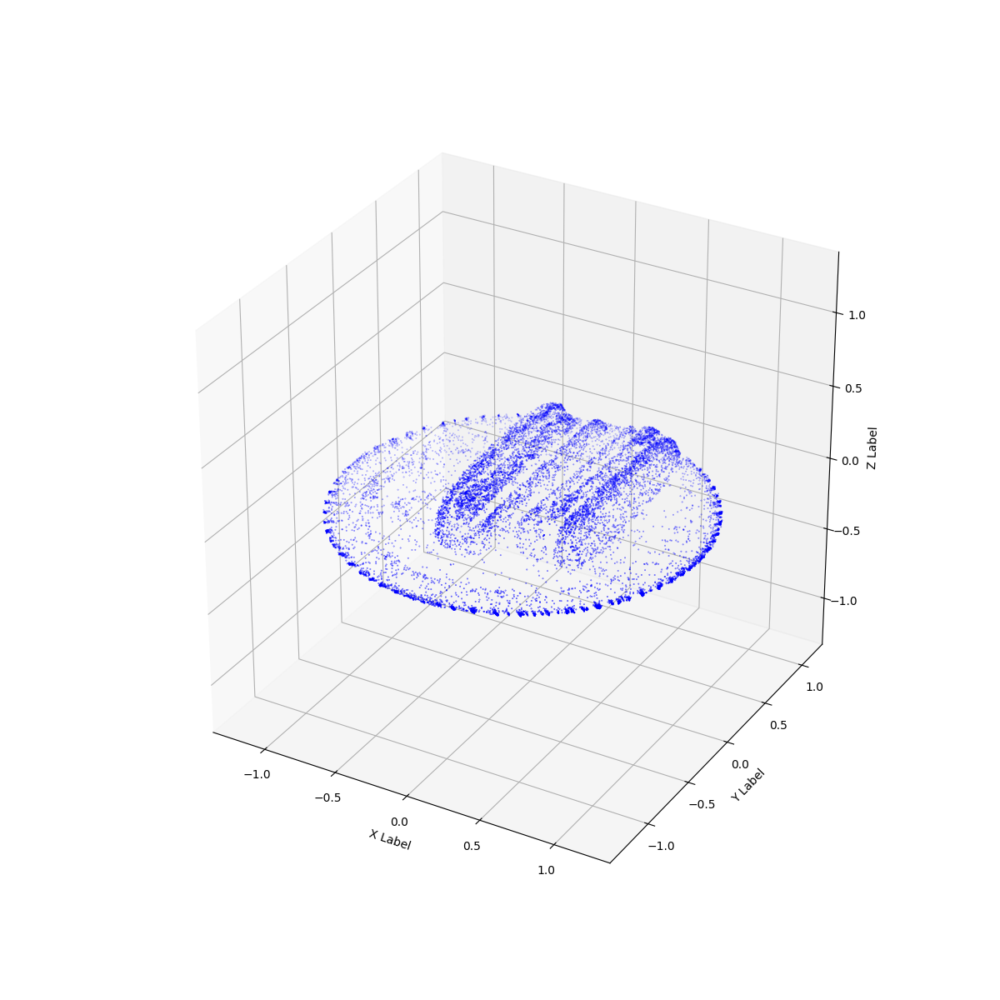

In [954]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=10
if True:
    arr = content_gaussians._xyz.data.detach().cpu().numpy()
    ax.scatter(arr[::kth,0], 
               arr[::kth,1], 
               arr[::kth,2], c='b', marker='o',s=0.1)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

In [966]:
all_points = content_gaussians._xyz.data.detach().cpu().numpy()

all_points = np.array(all_points)
all_points_idcs = np.random.choice(range(len(all_points)), size=50000, replace=False) 
content_surface_pc = all_points[all_points_idcs]

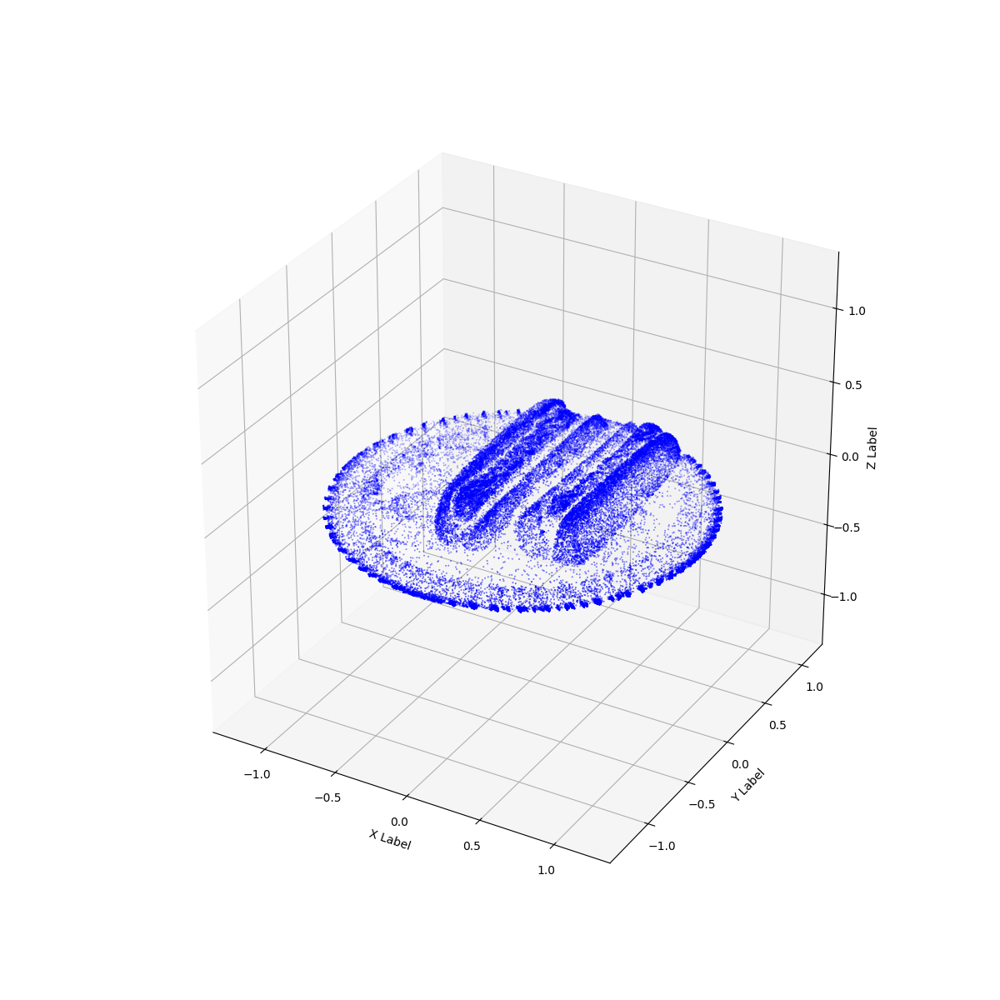

In [967]:
# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c='b', marker='o',s=0.1)



# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()

# Initialization for optimization

In [968]:

import torch
import torch.nn.functional as F
from scipy.spatial import distance
import numpy as np
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA


def sample_points_by_density(points, num_samples=None, radius = 0.05, device='cuda'):
    """
    Samples points inversely proportional to their density in the neighborhood.
    :param points: torch tensor of shape [N,3]
    :param num_samples: Number of samples to be drawn according to the
        distribution of densities. If None, then we sample 1/10th of the points.
    :param radius: Radius of the local region around each point at which we compute
        the number of neighbors.
    :param device: Device on which the tensors are stored and computations will be done.
    :return: A torch tensor of shape [num_samples] containing the indices of the sampled points
    """


    # Assuming you have a PyTorch tensor of shape [N, 3] representing points
    # Calculate pairwise distances between all points
    # Note that i only compute distance to every 10th neighbor.
    distances = torch.cdist(points, points[::10])


    # Calculate the number of points within the local region for each point
    num_points_in_local_region = (distances <= radius).sum(dim=1)

    # Calculate the inverse density as a weight
    inverse_density = 1.0 / (num_points_in_local_region + 1)  # Add 1 to avoid division by zero

    # Normalize the weights to create a probability distribution
    probability_distribution = inverse_density / inverse_density.sum()

    # Sample points inversely proportional to their density
    if num_samples is None:
        num_samples = len(points) // 10  # Adjust the number of samples as needed
    sampled_indices = torch.multinomial(probability_distribution, num_samples, replacement=True)

    return sampled_indices
    
def remove_outliers(points, kth_neighbor=30, q=0.925, device='cuda'):
    """
    Removes outliers from the given points. Usually the set of clusters must be small to avoid
    quadratic complexity of the all pairwise neighbors computation.
    :param points: torch tensor of shape [N, 3]
    :param kth_neighbor: this neighbor we use to approximate good neighborhood density.
    :param q: Quantile to use for removing outliers.
    :param device: Device on which the tensors are stored and computations will be done.
    :return: A torch tensor of shape [N] containing the indices of the non-outlier points.
    """

    pairwise_distances = torch.cdist(points, points)
    kth_nearest_dists, kth_nearest_indices = torch.topk(pairwise_distances, k=kth_neighbor, dim=1, largest=False, sorted=True)
    q_outliers = torch.quantile(kth_nearest_dists[:, kth_neighbor-1], q=q)
    indcs_relevant = torch.where(kth_nearest_dists[:, kth_neighbor-1] < q_outliers)[0]
    return indcs_relevant

def prepare_scene(points, num_clusters=40, num_samples=None, radius=0.05, q=0.925, device='cuda'):
    """
    Prepares the scene by sampling points and clustering them.
    :param points: torch tensor of shape [N, 3]
    :param num_clusters: Number of clusters to use for KMeans clustering.
    :param num_samples: Number of samples to be drawn according to the
        distribution of densities. If None, then we sample 1/10th of the points from EACH cluster
    :param radius: Radius of the local region around each point at which we compute
        the number of neighbors.
    :param device: Device on which the tensors are stored and computations will be done.
    :return: A tuple containing the following tensors:
    """

     # Use KMeans clustering to find the centroids of the clusters
    kmeans = KMeans(init="k-means++", n_clusters=num_clusters, n_init=4)
    kmeans.fit(points.detach().cpu().numpy())
    clean_indices = []
    for lbls in np.unique(kmeans.labels_):
        cluster_points_idcs = np.where(kmeans.labels_ == lbls)[0]
        # Remove outliers
        non_outliers_idcs = remove_outliers(points[cluster_points_idcs], q=q, device=device)
        cluster_points_idcs = cluster_points_idcs[non_outliers_idcs.cpu().numpy()]
        # Sample points inversely proportional to the density
        sampled_idcs = sample_points_by_density(points[cluster_points_idcs], num_samples, radius, device)
        cluster_points_idcs = cluster_points_idcs[sampled_idcs.cpu().numpy()]
        clean_indices.append(cluster_points_idcs)

    return clean_indices, kmeans.cluster_centers_, kmeans.labels_[np.concatenate(clean_indices)]


In [969]:
content_surface_pc.shape

(50000, 3)

In [970]:
content_shape_idcs, content_shape_cluster_centers, content_shape_cluster_labels = prepare_scene(
        points=torch.tensor(content_surface_pc).to(device=device),
    num_samples=None,
    radius=0.035,
    q=0.975, #0.975,
    num_clusters=200,
    device=device)


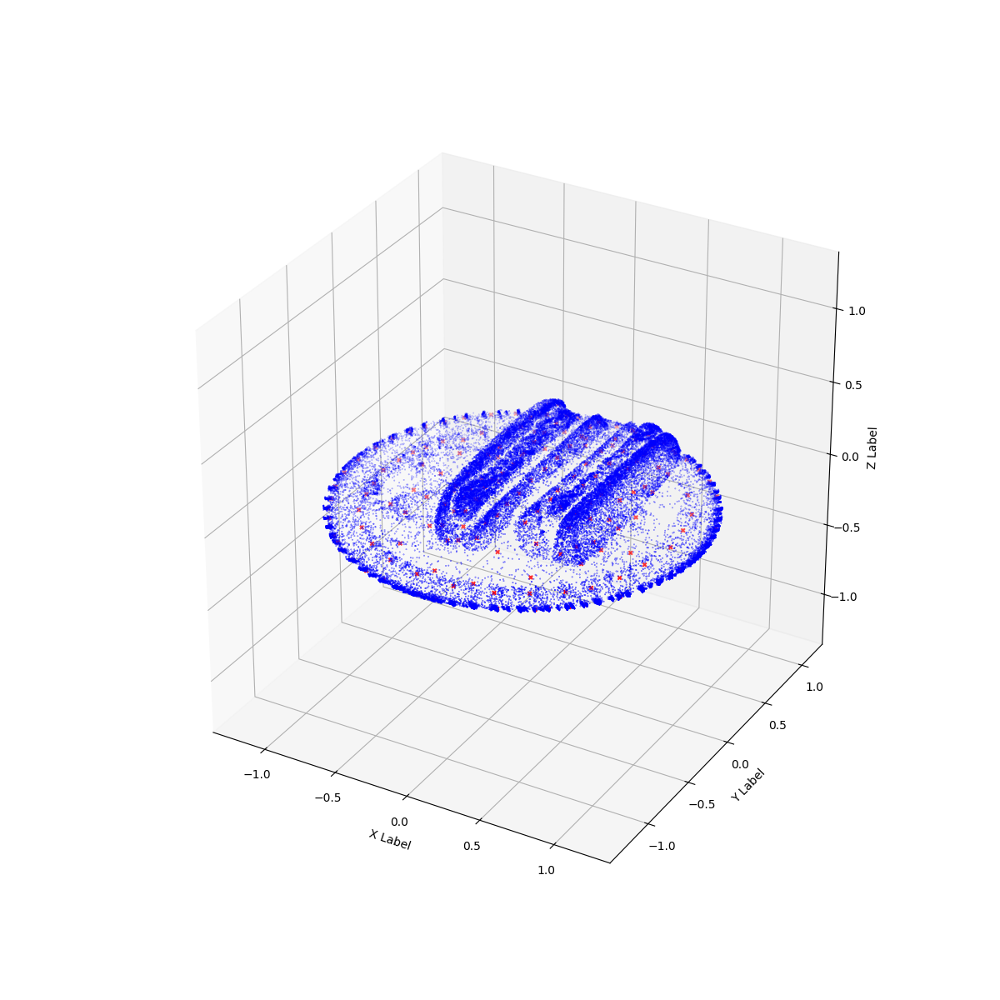

In [971]:


# Create a 3D scatter plot
fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
ax.set_aspect('equal')
# Plot target shape

# Plot the scatter points
kth=1
if True:
    ax.scatter(content_surface_pc[::kth,0], 
               content_surface_pc[::kth,1], 
               content_surface_pc[::kth,2], c='b', marker='o',s=0.1)

ax.scatter(content_shape_cluster_centers[:, 0],
           content_shape_cluster_centers[:, 1],
           content_shape_cluster_centers[:, 2],
           c='r', marker='x', s=10.)

# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()



# Cluster loading and preparation

In [979]:

loaded_data = np.load("/home/dimakot55/output_data/gs/GT_lego_spheres_v5_clusters_100/cluster_51.npz") # 51, 36, 49, 24, 40, 57, 45, 22, 20, 3, 32, 25,  19, 16, 17, 15, 13, 14

# loaded_data = np.load("/home/dimakot55/output_data/gs_my/GT_brickwall_spheres_clusters_50/cluster_14.npz") # 51, 36, 49, 24, 40, 57, 45, 22, 20, 3, 32, 25,  19, 16, 17, 15, 13, 14

# Access the arrays by their names
gaussians_xyz = loaded_data['_xyz']
gaussians_features_dc = loaded_data['_features_dc']
gaussians_features_rest = loaded_data['_features_rest']
gaussians_rotation = loaded_data['_rotation']
gaussians_scaling = loaded_data['_scaling']
gaussians_opacity = loaded_data['_opacity']

# 0. only for the bricks scene. Remove poitns underneath. and change size to smaller scale. Multiply coordinates and sizes.
idcs = np.where(gaussians_xyz[:,2]>-0.12)[0]
gaussians_xyz = gaussians_xyz[idcs]
gaussians_features_dc = gaussians_features_dc[idcs]
gaussians_features_rest = gaussians_features_rest[idcs]
gaussians_rotation = gaussians_rotation[idcs]
gaussians_scaling = gaussians_scaling[idcs]
gaussians_opacity = gaussians_opacity[idcs]




# 1. Remove poitns that are too far away from all other points. These are just noise
# Compute all pairwise distances between points
from scipy.spatial import distance
k=30
pairwise_distances = distance.cdist(gaussians_xyz, gaussians_xyz, 'euclidean')
# Use np.partition to find the k-th smallest distances for each row
kth_nearest_indices = np.argpartition(pairwise_distances, k, axis=1)[:, :k]
kth_nearest_distances = np.take_along_axis(pairwise_distances, kth_nearest_indices, axis=1)
q_outliers = np.quantile(np.max(kth_nearest_distances, axis=-1), 0.925)
idcs = np.where(np.max(kth_nearest_distances, axis=-1) < q_outliers)[0]
gaussians_xyz = gaussians_xyz[idcs]
gaussians_features_dc = gaussians_features_dc[idcs]
gaussians_features_rest = gaussians_features_rest[idcs]
gaussians_rotation = gaussians_rotation[idcs]
gaussians_scaling = gaussians_scaling[idcs]
gaussians_opacity = gaussians_opacity[idcs]

# preprocess colors
colors = np.array(gaussians_features_dc[:,0])
#colors = (colors - np.min(colors)) / (np.max(colors) - np.min(colors))
def sigmoid(x):
    return 1 / (1 + np.exp(-x))
colors=sigmoid(colors)

# preprocess sizes. Transform scaling to a format somewhat acceptable 
# by the ax.scatter function
sizes = np.array(gaussians_scaling[:,0])
q05 = np.quantile(sizes, 0.5)
#sizes = sizes * (sizes > q05)
sizes = -sizes * 4. 

# Transform opacity to the format acceptable by ax.scatter
alpha = np.array(gaussians_opacity[:,0])
#alpha = alpha / np.max(alpha)
alpha = np.clip(alpha, 0., 1.)


# Extra increase the volume of the points to make results more apparent
with torch.no_grad():
    # gaussians_xyz[:,2] = gaussians_xyz[:,2]*1.5 # for lego
    gaussians_xyz[:,2] = gaussians_xyz[:,2]*1.0 # for bricks 

[   0    1    2 ... 2711 2712 2713]


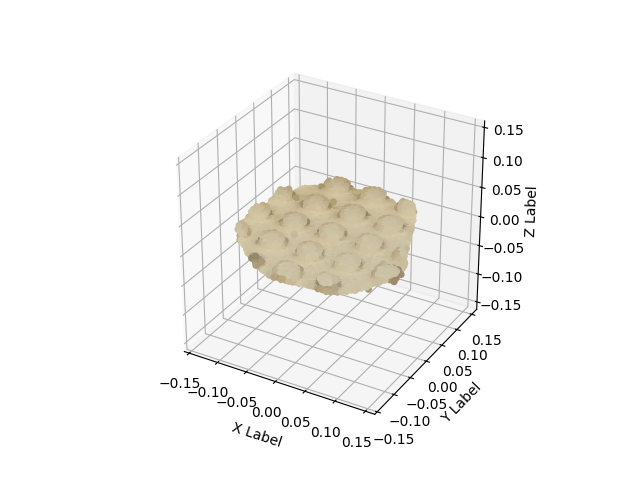

In [980]:


# Create a 3D scatter plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
#ax.set_aspect('equal')
# Plot the scatter points
idcs = np.where(gaussians_xyz[:,2]>-0.25)[0]
print(idcs)
ax.scatter(gaussians_xyz[idcs,0], 
           gaussians_xyz[idcs,1], 
           gaussians_xyz[idcs,2],#*1.5, 
           c=np.concatenate([colors, alpha[:,None]], axis=-1)[idcs],# c='b', 
           marker='o',
           s=sizes[idcs], #s=25.,
           #alpha=alpha,
           depthshade=False,
           edgecolors='none')
           #fillstyle='full',
           #markeredgecolor='red',
           #markeredgewidth=0.0)

# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')
ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()





In [981]:
gaussians_features_dc

array([[[ 0.66404116,  0.3750265 , -0.19959316]],

       [[ 1.4526384 ,  1.1696191 ,  0.61010534]],

       [[ 1.39191   ,  1.1111531 ,  0.5334526 ]],

       ...,

       [[ 1.0513786 ,  0.7312011 ,  0.10313889]],

       [[ 1.2186831 ,  0.97561884,  0.43354657]],

       [[ 1.0861913 ,  0.7459172 ,  0.16366225]]], dtype=float32)

In [982]:
np.median(gaussians_features_dc, axis=0, keepdims=True)

array([[[1.3229752 , 1.0436736 , 0.45582765]]], dtype=float32)

In [976]:
# Change all colors to median values
gaussians_features_dc = gaussians_features_dc*0. + np.median(gaussians_features_dc, axis=0, keepdims=True)
# preprocess colors
colors = np.array(gaussians_features_dc[:,0])
#colors = (colors - np.min(colors)) / (np.max(colors) - np.min(colors))
def sigmoid(x):
    return 1 / (1 + np.exp(-x))
colors=sigmoid(colors)

In [977]:
colors

array([[0.7896763 , 0.7395582 , 0.61202395],
       [0.7896763 , 0.7395582 , 0.61202395],
       [0.7896763 , 0.7395582 , 0.61202395],
       ...,
       [0.7896763 , 0.7395582 , 0.61202395],
       [0.7896763 , 0.7395582 , 0.61202395],
       [0.7896763 , 0.7395582 , 0.61202395]], dtype=float32)

[   0    1    2 ... 2711 2712 2713]


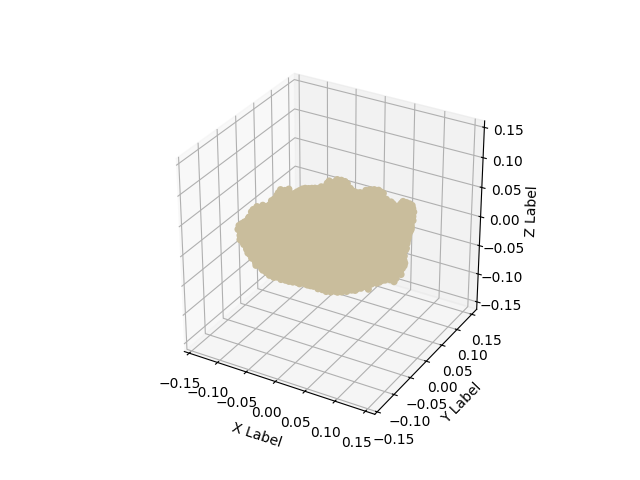

In [978]:


# Create a 3D scatter plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
#ax.axis('equal')
#ax.set_aspect('equal')
# Plot the scatter points
idcs = np.where(gaussians_xyz[:,2]>-0.25)[0]
print(idcs)
ax.scatter(gaussians_xyz[idcs,0], 
           gaussians_xyz[idcs,1], 
           gaussians_xyz[idcs,2],#*1.5, 
           c=np.concatenate([colors, alpha[:,None]], axis=-1)[idcs],# c='b', 
           marker='o',
           s=sizes[idcs], #s=25.,
           #alpha=alpha,
           depthshade=False,
           edgecolors='none')
           #fillstyle='full',
           #markeredgecolor='red',
           #markeredgewidth=0.0)

# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')
ax.set_box_aspect([1,1,1]) # IMPORTANT - this is the new, key line
# ax.set_proj_type('ortho') # OPTIONAL - default is perspective (shown in image above)
set_axes_equal(ax) # IMPORTANT - this is also required
plt.show()





In [983]:
gaussians_opt = GaussianModel(3)#.to(device="cuda")
scene_opt = Scene(dataset, gaussians_opt, shuffle=True)


Found transforms_train.json file, assuming Blender data set!
Reading Training Transforms
Reading Test Transforms
Loading Training Cameras
Loading Test Cameras
Number of points at initialisation :  100000


In [984]:
content_shape_cluster_centers

array([[-0.15726842,  0.4292936 ,  0.2912843 ],
       [ 0.69534576, -0.79841435, -0.08979517],
       [-0.7304857 , -0.7444695 , -0.10177736],
       [ 0.5803833 , -0.1641042 ,  0.21534336],
       [-0.07280819, -0.7230092 , -0.00750237],
       [ 0.58525264,  0.6013552 ,  0.1950757 ],
       [ 1.174907  , -0.15185533, -0.08007343],
       [-0.93299246,  0.17505032, -0.09444854],
       [-0.04095872,  0.0021873 ,  0.2413003 ],
       [-0.09730108,  0.85842   , -0.09485133],
       [-0.7458294 ,  0.8069856 , -0.08056504],
       [-0.02400029, -1.2624347 , -0.07965222],
       [ 0.94929   ,  0.60462284, -0.07978968],
       [-0.03582999, -0.47616172,  0.24123083],
       [-1.1531258 , -0.26635933, -0.08202139],
       [ 0.45521623, -1.1707896 , -0.08017091],
       [ 1.0759746 , -0.5641834 , -0.07996234],
       [ 0.34438527, -0.5282338 , -0.00798126],
       [ 0.4186948 ,  0.22070858,  0.18956675],
       [ 0.44874537,  0.9793817 , -0.07967091],
       [-0.60582596, -0.44967434, -0.111

In [985]:
C = len(content_shape_cluster_centers)
gaussians_opt._features_dc.data = torch.concat([torch.tensor(gaussians_features_dc)]*C).to(device=device)
gaussians_opt._features_rest.data = torch.concat([torch.tensor(gaussians_features_rest)*0.]*C).to(device=device)
gaussians_opt._rotation.data = torch.concat([torch.tensor(gaussians_rotation)]*C).to(device=device)
gaussians_opt._scaling.data = torch.concat([torch.tensor(gaussians_scaling)]*C).to(device=device)
gaussians_opt._opacity.data = torch.concat([torch.tensor(gaussians_opacity)]*C).to(device=device)

N = len(gaussians_xyz)

gaussians_opt.max_radii2D.data = torch.concat([torch.tensor(content_gaussians.max_radii2D[:N])]*C).to(device=device)
gaussians_opt.xyz_gradient_accum.data = torch.concat([torch.tensor(content_gaussians.xyz_gradient_accum[:N])]*C).to(device=device)
gaussians_opt.denom.data = torch.concat([torch.tensor(content_gaussians.denom[:N])]*C).to(device=device)

# gaussians_opt._xyz.data = torch.concat([torch.tensor( (gaussians_xyz - np.mean(gaussians_xyz, axis=0))*2. + cluster_center).to(device=device) 
#                                           for cluster_center in content_shape_cluster_centers])



# Make clusters double the size 
# gaussians_opt._xyz.data = torch.concat([torch.tensor( (gaussians_xyz - np.mean(gaussians_xyz, axis=0))*2.0 + cluster_center).to(device=device) 
#                                           for cluster_center in content_shape_cluster_centers])

/tmp/ipykernel_540449/1176114783.py:10: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gaussians_opt.max_radii2D.data = torch.concat([torch.tensor(content_gaussians.max_radii2D[:N])]*C).to(device=device)
/tmp/ipykernel_540449/1176114783.py:11: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gaussians_opt.xyz_gradient_accum.data = torch.concat([torch.tensor(content_gaussians.xyz_gradient_accum[:N])]*C).to(device=device)
/tmp/ipykernel_540449/1176114783.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  gaussians_opt.denom.data = torch.conca

In [986]:
gaussians_opt_features_dc_original = gaussians_opt._features_dc.data.detach().clone()


# gaussians_opt._xyz.data = torch.concat([torch.tensor( (gaussians_xyz - np.mean(gaussians_xyz, axis=0))*2. + cluster_center).to(device=device) 
#                                           for cluster_center in content_shape_cluster_centers])
# gaussians_opt._scaling.data +=  1.5


# gaussians_opt._xyz.data = torch.concat([torch.tensor( (gaussians_xyz - np.mean(gaussians_xyz, axis=0))*1. + cluster_center).to(device=device) 
#                                           for cluster_center in content_shape_cluster_centers])
# gaussians_opt._scaling.data +=  0.5




# gaussians_opt._xyz.data = torch.concat([torch.tensor( (gaussians_xyz - np.mean(gaussians_xyz, axis=0))*1.5 + cluster_center).to(device=device) 
#                                           for cluster_center in content_shape_cluster_centers])
# gaussians_opt._scaling.data +=  1.5



gaussians_opt._xyz.data = torch.concat([torch.tensor( (gaussians_xyz - np.mean(gaussians_xyz, axis=0))*1. + cluster_center).to(device=device) 
                                          for cluster_center in content_shape_cluster_centers])
gaussians_opt._scaling.data +=  .3



# gaussians_opt._xyz.data = torch.concat([torch.tensor( (gaussians_xyz - np.mean(gaussians_xyz, axis=0))*1. + cluster_center).to(device=device) 
#                                           for cluster_center in content_shape_cluster_centers])
# gaussians_opt._scaling.data +=  0.0



# gaussians_opt._xyz.data = torch.concat([torch.tensor( (gaussians_xyz - np.mean(gaussians_xyz, axis=0))*1.25 + cluster_center).to(device=device) 
#                                           for cluster_center in content_shape_cluster_centers])
# gaussians_opt._scaling.data +=  1. # .75

In [100]:
gaussians_opt._scaling.data -=  1.5

In [987]:
viewpoint_stack = content_scene.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))


In [988]:

render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]

render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]



In [989]:
gaussians_opt._xyz.data

tensor([[-0.2328,  0.5466,  0.2963],
        [-0.1935,  0.3063,  0.2891],
        [-0.2495,  0.4114,  0.2891],
        ...,
        [-0.8977,  0.8206, -0.0795],
        [-0.8672,  0.5902, -0.0817],
        [-0.9826,  0.7096, -0.0820]], device='cuda:0')

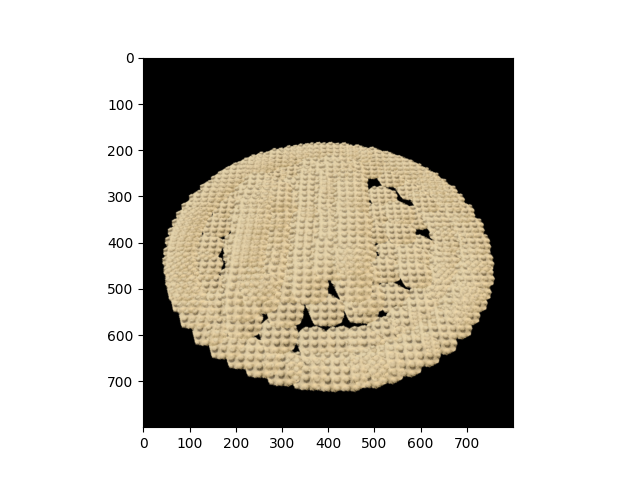

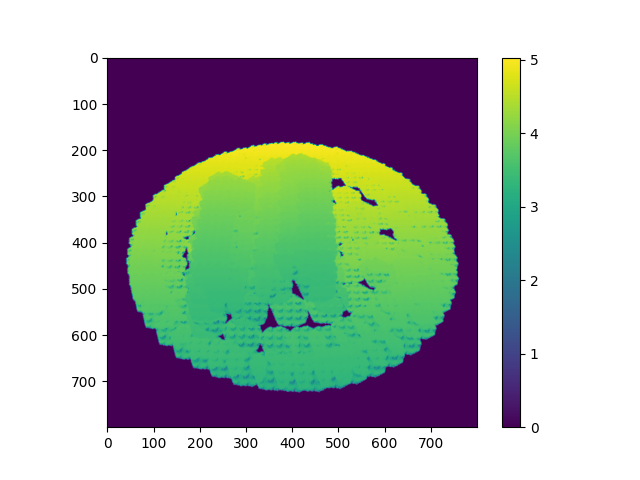

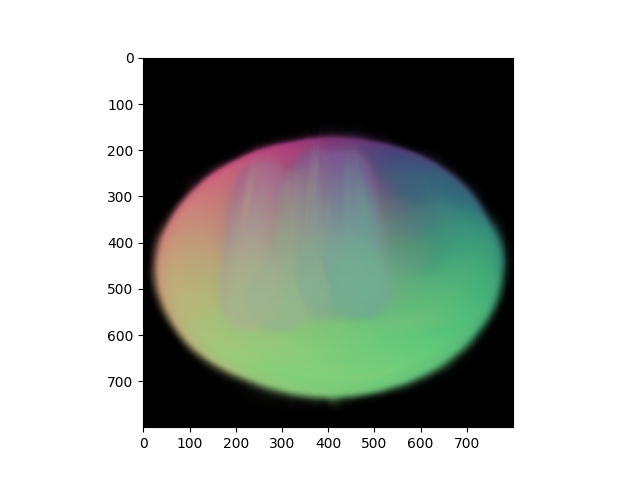

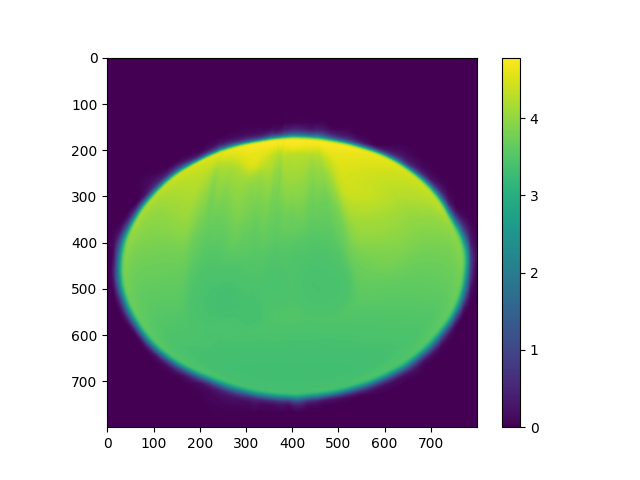

In [990]:
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()


depth_np = depth.detach().cpu().numpy()

plt.figure()
plt.imshow(depth_np)
plt.colorbar()
plt.show()

image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()


depth_np = depth_cont.detach().cpu().numpy()

plt.figure()
plt.imshow(depth_np)
plt.colorbar()
plt.show()

In [991]:

with torch.no_grad():
    gaussians_opt._features_dc.data = gaussians_opt._xyz.data.clone().detach().unsqueeze(1)
    gaussians_opt._features_rest.data = gaussians_opt._features_rest.data * 0.

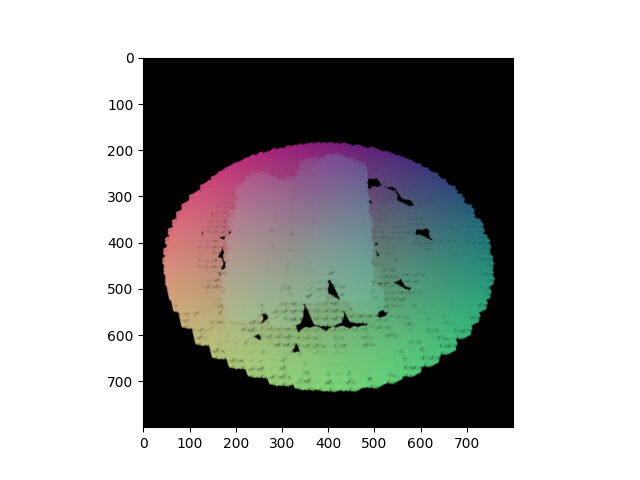

In [992]:

# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]

image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()


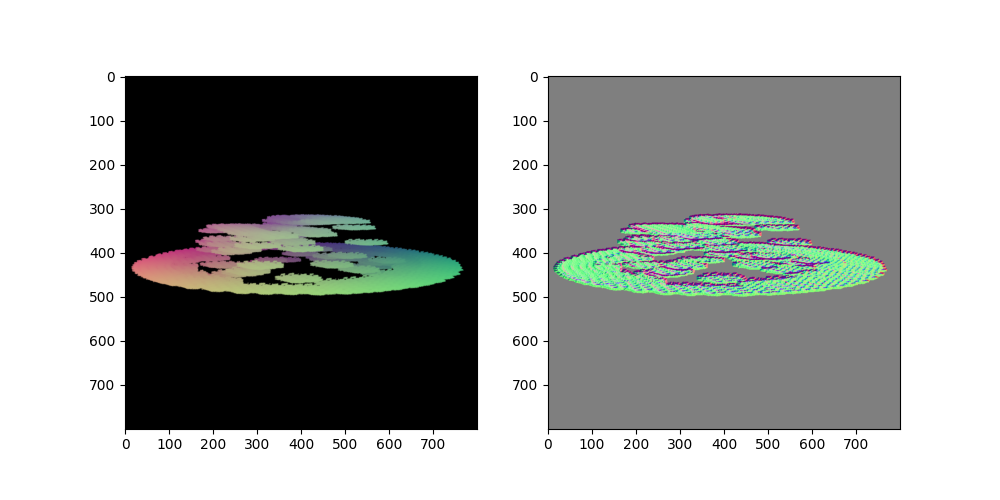

In [993]:
# Sample camera
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

# Compute normals
K = torch.tensor([[1111, 0, 400],
                  [0, 1111, 400],
                  [0, 0,    1  ]], dtype=torch.float32).unsqueeze(0).to(device="cuda")
normals = kornia.geometry.depth.depth_to_normals(depth=depth.unsqueeze(0).unsqueeze(0),
                                                 camera_matrix=K,
                                                 normalize_points=False)
image_normals = normals.squeeze(0)
mins = torch.amin(image_normals, dim=(0, 1, 2), keepdim=True)
maxs = torch.amax(image_normals, dim=(0, 1, 2), keepdim=True)
image_normals = (image_normals - mins) / (maxs - mins + 1e-6)


fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
ax[0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

In [994]:

def get_descriptors(X, X_nns_indices):
    """
    Returns a matrix of distances between all points specified in the X_nns_indices matrix.
    :param X: tensor or shape [N,d]
    :param X_nns_indices: tensor of shape [N,k]
    :return 
        distances_nns : tensor of shape [N, k,k] with pairwise distances between all of the 
            k NNs for every sample in X.
    """
    
    X_nns = X[X_nns_indices]
    # All pairs can be too much
    # distances_nns = torch.norm(X_nns.unsqueeze(1) - X_nns.unsqueeze(2), dim=-1)
    # Just take all distances to the nearest neighbors
    distances_nns = torch.norm(X_nns[:,1:] - X_nns[:,0].unsqueeze(1), dim=-1)
    return distances_nns
    
def get_style_patch_descriptors_loss(clusters_to_opt_list, nns_indices, target_descriptor_cluster):
    """
    For every cluster of points in the clusters_to_opt_list we compute its descriptor of spatial 
    positions between all pairs of points within this cluster. Afterwards we compare this descriptor
    with the target descriptor.
    """
    loss_local_descriptor_list = []
    loss = 0.
    for cluster_points in clusters_to_opt_list:
        descriptor_points = get_descriptors(X=cluster_points, X_nns_indices=nns_indices)
        loss_local_descriptor = torch.mean(torch.square(descriptor_points - target_descriptor_cluster))
        loss += loss_local_descriptor 
        loss_local_descriptor_list.append(loss_local_descriptor)

    return loss / len(clusters_to_opt_list)


# now find initial desctiptors 

num_nns = 200
kth_nn = 20
num_nns_local = 100 # was 100
kth_nn_local = 1

distances = torch.cdist(gaussians_opt._xyz.data[:N], gaussians_opt._xyz.data[:N])
_, nns_indices = torch.topk(distances, k=num_nns, largest=False, dim=-1)

nns_indices = nns_indices[:, ::kth_nn]

target_descriptor_cluster = get_descriptors(X=gaussians_opt._xyz.data[:N], 
                                            X_nns_indices=nns_indices)
target_descriptor_cluster = target_descriptor_cluster.clone().detach()
target_descriptor_cluster.shape


torch.Size([2714, 9])

In [995]:


get_style_patch_descriptors_loss(clusters_to_opt_list=[gaussians_opt._xyz[:N]],
                                 nns_indices=nns_indices,
                                 target_descriptor_cluster=target_descriptor_cluster)



tensor(0., device='cuda:0', grad_fn=<DivBackward0>)

In [996]:
def calculate_ema(values, alpha=0.01):
    ema = [values[0]]  # Initial value is the same as the first value in the list

    for i in range(1, len(values)):
        ema.append(alpha * values[i] + (1 - alpha) * ema[-1])

    return ema


def l1_loss(network_output, gt):
    return torch.abs((network_output - gt)).mean()


def tv_loss(img):
    return 0.5 * (torch.abs(img[..., 1:, :] - img[..., :-1, :]).mean() +
                  torch.abs(img[..., :, 1:] - img[..., :, :-1]).mean())



In [997]:
losses_full=[]
losses_pixel = []
losses_reg = []
losses_tv = []
losses_loc_descr = []


gaussians_opt.training_setup(opt)
# for param_group in gaussians_opt.optimizer.param_groups:
#         param_group['lr'] = 1e-4


gaussians_opt._xyz.requires_grad = True
gaussians_opt._features_dc.requires_grad = True
gaussians_opt._features_rest.requires_grad = False
gaussians_opt._scaling.requires_grad = False
gaussians_opt._rotation.requires_grad = False
gaussians_opt._opacity.requires_grad = False
gaussians_opt.max_radii2D.requires_grad = False


In [1064]:

# Random sampling viewpoint



# def loss_to_depth_target(d, d_trg):
#     return torch.mean(torch.square(d - d_trg) * (d_trg>0.5))

def loss_to_depth_target(d, d_trg):
    return torch.mean(torch.square(d - d_trg))


from torchvision.transforms import v2
blurrer = v2.GaussianBlur(kernel_size=(31, 31), sigma=(30., 30.))


def loss_to_depth_target(d, d_trg, make_BG_large=False, blur_depth=False, blr_sgm=1.):
    d_ = d
    d_trg_ = d_trg
    if make_BG_large:
        d_trg_ = d_trg_ + (d_trg_<1e-2) * 1e2
    if blur_depth:
        d_ = gaussian_filter_2d(d_, sigma=blr_sgm)
        d_trg_ = gaussian_filter_2d(d_trg_, sigma=blr_sgm)
    return torch.mean(torch.square(d_ - d_trg_))# * (d_trg>0.01))

def renorm_cluster(cluster):
    """
    Provided a cluster of coordinates center it and normalize
    """
    return (cluster - torch.mean(cluster, dim=-1, keepdim=True)) / torch.std(cluster, dim=-1, keepdim=True)
    
if True:
    for step in tqdm(range(5001)):
        gaussians_opt.optimizer.zero_grad()
        # Pick a random Camera
        
        if not viewpoint_stack:
            viewpoint_stack = scene_opt.getTrainCameras().copy()
        
        # if step < 2:
        viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))
        # Optimization gaussians
        render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
        image, depth= render_pkg["render"], render_pkg["depth"]
        # Content gaussians
        render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
        image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

        depth_target = depth_cont.clone().detach().to(device=device)

        
        # loss_descriptor_local = get_style_patch_descriptors_loss(
        #     clusters_to_opt_list=[renorm_cluster(gaussians_opt._xyz[i*N:(i+1)*N]) 
        #                           for i in range(C)],
        #     nns_indices=nns_indices,
        #     target_descriptor_cluster=target_descriptor_cluster)
        loss_descriptor_local = get_style_patch_descriptors_loss(
            clusters_to_opt_list=[gaussians_opt._xyz[i*N:(i+1)*N] for i in range(C)],
            nns_indices=nns_indices,
            target_descriptor_cluster=target_descriptor_cluster)


        #loss_pixel = torch.mean(torch.square(image - image_cont))
        loss_pixel = l1_loss(image, image_cont)
        loss_depth = l1_loss(depth, depth_cont)
        l_tv = tv_loss(image)
        l_reg = torch.mean(torch.square(gaussians_opt._xyz.unsqueeze(1) - gaussians_opt._features_dc))
        
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e3# tv_loss weight was 1e-3
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e0# tv_loss weight was 1e-3
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e1# tv_loss weight was 1e-3
        # Stage 1 
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e-4
        # Stage 2 
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e-3
        # # Stage 3
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e-1
        # # Stage 4
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e0
        # Stage 5
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e2
        #loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 #+ loss_descriptor_local * 1e-4
        
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e3
        # loss = loss_pixel * 1e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 1e4
        loss = loss_pixel * 5e0  + l_tv * 1e-5 + l_reg * 1e1 + loss_descriptor_local * 4e4 # was 1e4
        # loss = loss_depth
        loss.backward()
    
        gaussians_opt.optimizer.step()
        losses_full.append(float(loss.detach().cpu().numpy()))
        losses_pixel.append(float(loss_pixel.detach().cpu().numpy()))
        losses_reg.append(float(l_reg.detach().cpu().numpy()))
        losses_tv.append(float(l_tv.detach().cpu().numpy()))
        losses_loc_descr.append(float(loss_descriptor_local.detach().cpu().numpy()))
  
    

        
        if step % 100 == 0:
            print(f"l_reg:{l_reg:.7f}, loss_descriptor_local:{loss_descriptor_local:.7f},",
                  f"l_tv:{l_tv:.7f}, loss_pixel:{loss_pixel:.7f}, loss:{loss:.7f}")

   



/tmp/ipykernel_540449/1589854571.py:33: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for step in tqdm(range(5001)):


  0%|          | 0/5001 [00:00<?, ?it/s]

l_reg:0.0006512, loss_descriptor_local:0.0000001, l_tv:0.0029229, loss_pixel:0.0649820, loss:0.3358416
l_reg:0.0006981, loss_descriptor_local:0.0000002, l_tv:0.0025915, loss_pixel:0.0618643, loss:0.3225478
l_reg:0.0005994, loss_descriptor_local:0.0000002, l_tv:0.0017110, loss_pixel:0.0340790, loss:0.1833386
l_reg:0.0004621, loss_descriptor_local:0.0000002, l_tv:0.0016895, loss_pixel:0.0261602, loss:0.1432278
l_reg:0.0003526, loss_descriptor_local:0.0000002, l_tv:0.0012478, loss_pixel:0.0191981, loss:0.1076881
l_reg:0.0003182, loss_descriptor_local:0.0000002, l_tv:0.0011944, loss_pixel:0.0148466, loss:0.0858964
l_reg:0.0001998, loss_descriptor_local:0.0000002, l_tv:0.0018984, loss_pixel:0.0111272, loss:0.0661558
l_reg:0.0001688, loss_descriptor_local:0.0000002, l_tv:0.0015869, loss_pixel:0.0066514, loss:0.0431360
l_reg:0.0001452, loss_descriptor_local:0.0000002, l_tv:0.0014802, loss_pixel:0.0051306, loss:0.0350511
l_reg:0.0001381, loss_descriptor_local:0.0000002, l_tv:0.0010724, loss_pi

KeyboardInterrupt: 

In [1065]:
def calculate_ema(values, alpha=0.01):
    ema = [values[0]]  # Initial value is the same as the first value in the list

    for i in range(1, len(values)):
        ema.append(alpha * values[i] + (1 - alpha) * ema[-1])

    return ema


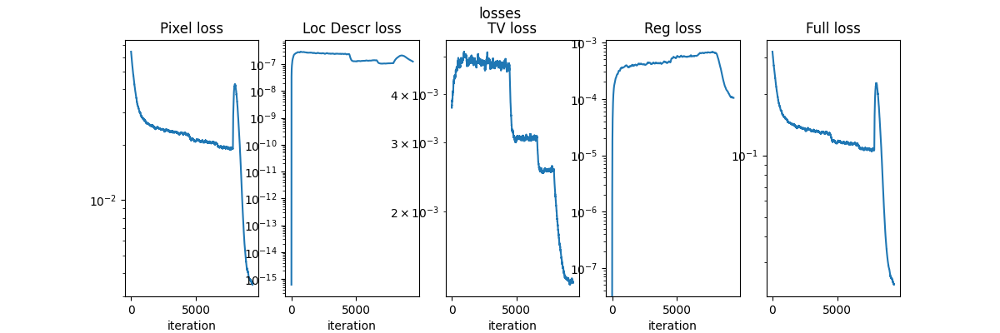

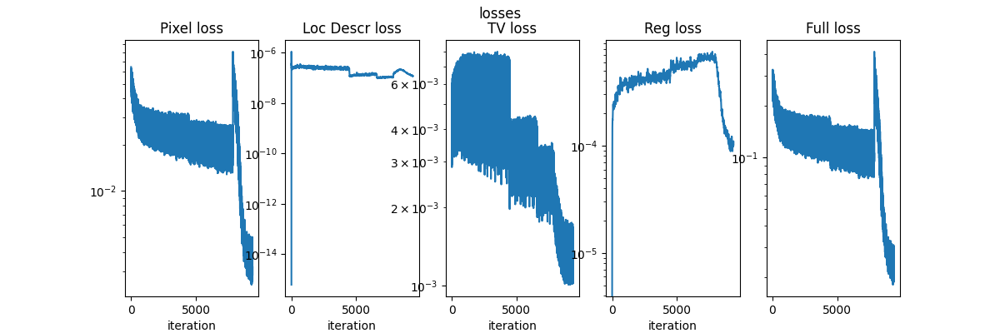

In [1066]:
fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(12,4))
fig.suptitle("losses")
ax[0].set_title("Pixel loss")
ax[0].plot(calculate_ema(losses_pixel))
ax[0].set_yscale('log')
ax[1].set_title("Loc Descr loss")
ax[1].plot(calculate_ema(losses_loc_descr))
ax[1].set_yscale('log')

ax[2].set_title("TV loss")
ax[2].plot(calculate_ema(losses_tv))
ax[2].set_yscale('log')
ax[3].set_title("Reg loss")
ax[3].plot(calculate_ema(losses_reg))
ax[3].set_yscale('log')
ax[4].set_title("Full loss")
ax[4].plot(calculate_ema(losses_full))
ax[4].set_yscale('log')

for i in range(4): ax[i].set_xlabel("iteration")

plt.show()

fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(12,4))
fig.suptitle("losses")
ax[0].set_title("Pixel loss")
ax[0].plot(losses_pixel)
ax[0].set_yscale('log')
ax[1].set_title("Loc Descr loss")
ax[1].plot(losses_loc_descr)
ax[1].set_yscale('log')

ax[2].set_title("TV loss")
ax[2].plot(losses_tv)
ax[2].set_yscale('log')
ax[3].set_title("Reg loss")
ax[3].plot(losses_reg)
ax[3].set_yscale('log')
ax[4].set_title("Full loss")
ax[4].plot(losses_full)
ax[4].set_yscale('log')

for i in range(4): ax[i].set_xlabel("iteration")

plt.show()


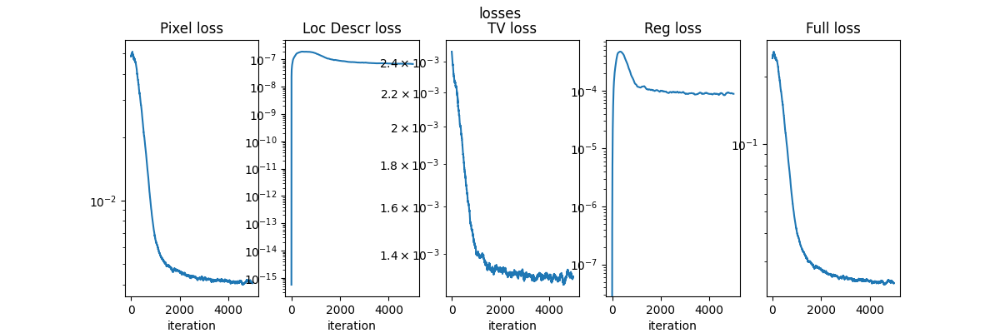

In [165]:
fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(12,4))
fig.suptitle("losses")
ax[0].set_title("Pixel loss")
ax[0].plot(calculate_ema(losses_pixel))
ax[0].set_yscale('log')
ax[1].set_title("Loc Descr loss")
ax[1].plot(calculate_ema(losses_loc_descr))
ax[1].set_yscale('log')

ax[2].set_title("TV loss")
ax[2].plot(calculate_ema(losses_tv))
ax[2].set_yscale('log')
ax[3].set_title("Reg loss")
ax[3].plot(calculate_ema(losses_reg))
ax[3].set_yscale('log')
ax[4].set_title("Full loss")
ax[4].plot(calculate_ema(losses_full))
ax[4].set_yscale('log')

for i in range(4): ax[i].set_xlabel("iteration")

plt.show()

fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(12,4))
fig.suptitle("losses")
ax[0].set_title("Pixel loss")
ax[0].plot(losses_pixel)
ax[0].set_yscale('log')
ax[1].set_title("Loc Descr loss")
ax[1].plot(losses_loc_descr)
ax[1].set_yscale('log')

ax[2].set_title("TV loss")
ax[2].plot(losses_tv)
ax[2].set_yscale('log')
ax[3].set_title("Reg loss")
ax[3].plot(losses_reg)
ax[3].set_yscale('log')
ax[4].set_title("Full loss")
ax[4].plot(losses_full)
ax[4].set_yscale('log')

for i in range(4): ax[i].set_xlabel("iteration")

plt.show()

In [1067]:
gaussians_opt_features_dc_fitted = gaussians_opt._features_dc.data.detach().clone()

In [1070]:
gaussians_opt._features_dc.data = gaussians_opt_features_dc_original.clone()

In [1068]:
# Sample camera
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))


In [1035]:
gaussians_opt._scaling.data +=  .5

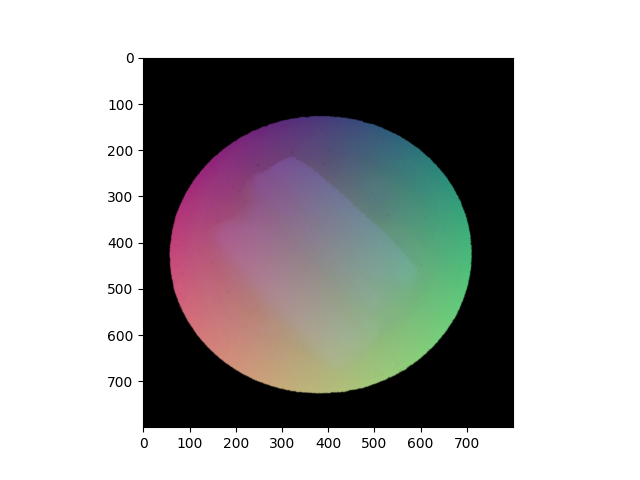

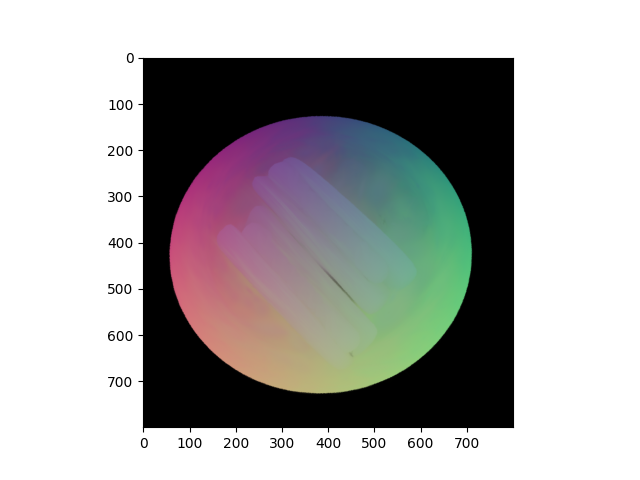

In [1069]:


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth_cont.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()

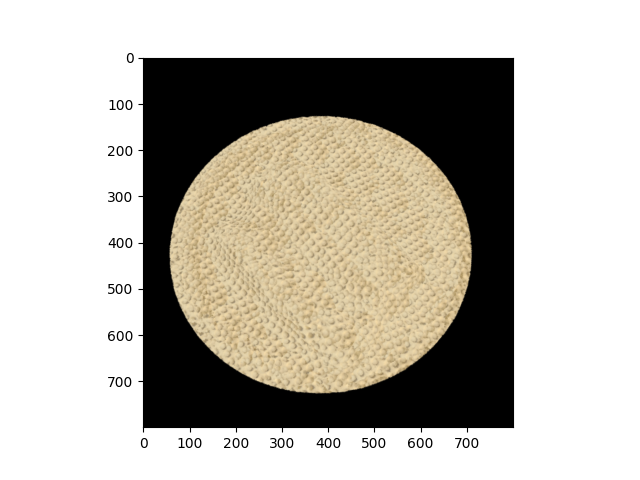

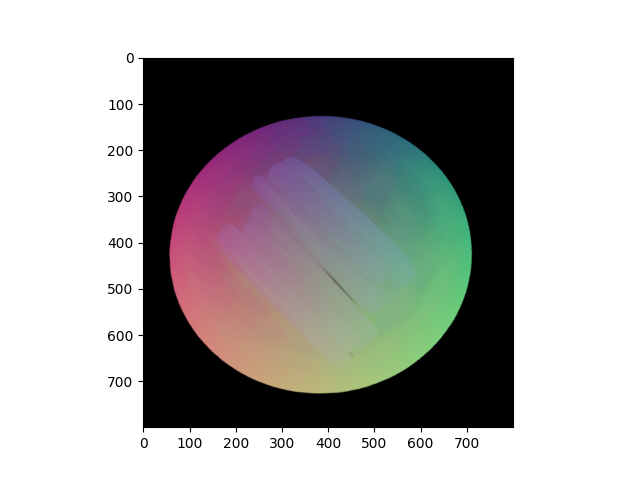

In [1071]:


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth_cont.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()

In [1041]:
gaussians_opt._scaling.data -= 0.5

In [1049]:
gaussians_opt._features_dc.data = gaussians_opt_features_dc_fitted.clone()

In [1013]:
image_normals.shape

torch.Size([3, 800, 800])

In [1014]:
import kornia

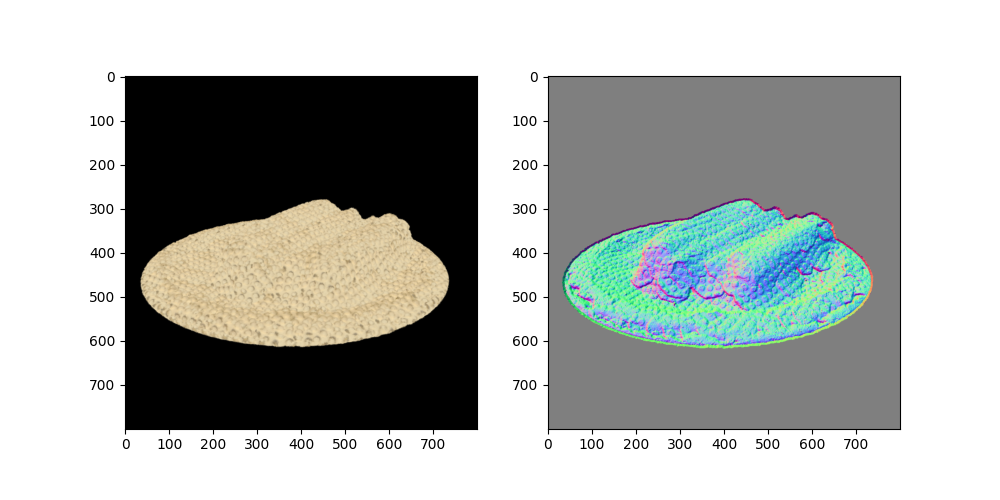

In [1072]:
# Sample camera
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

# Compute normals
K = torch.tensor([[1111, 0, 400],
                  [0, 1111, 400],
                  [0, 0,    1  ]], dtype=torch.float32).unsqueeze(0).to(device="cuda")
normals = kornia.geometry.depth.depth_to_normals(depth=depth.unsqueeze(0).unsqueeze(0),
                                                 camera_matrix=K,
                                                 normalize_points=True)
image_normals = normals.squeeze(0)
mins = torch.amin(image_normals, dim=(0, 1, 2), keepdim=True)
maxs = torch.amax(image_normals, dim=(0, 1, 2), keepdim=True)
image_normals = (image_normals - mins) / (maxs - mins + 1e-6)


fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
ax[0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

In [830]:
normals_homogeneous = torch.vstack((normals[0], torch.ones((1,)+normals[0].shape[1:], device=device)))
image_normals_world = torch.einsum('ij,jhw->ihw', viewpoint_cam.world_view_transform, -normals_homogeneous)
image_normals_world = image_normals_world[:3]
image_normals_world = image_normals_world / (1e-5 + torch.linalg.norm(image_normals_world,dim=0,keepdim=True))
# image_normals_world = torch.clip(image_normals_world, 0., 1.)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


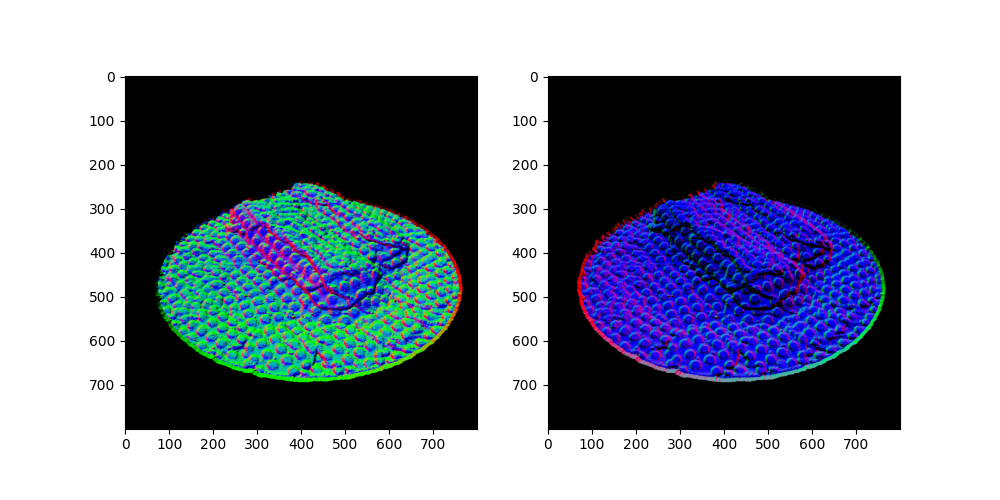

In [831]:

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
ax[0].imshow(normals[0].detach().cpu().numpy().transpose(1, 2, 0))
ax[1].imshow(image_normals_world.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


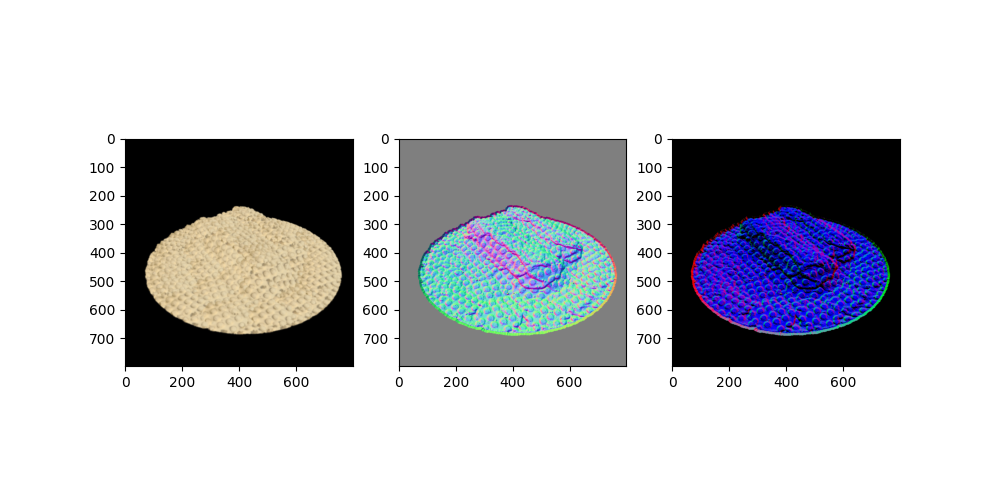

In [832]:


fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(10,5))
ax[0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
ax[2].imshow(image_normals_world.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

In [833]:
from skimage.restoration import (denoise_tv_chambolle, denoise_bilateral,
                                 denoise_wavelet, estimate_sigma)
# This bilateral thing with such a large sigma_spatial is very slow
# image_normals_np = image_normals.detach().cpu().numpy().transpose(1, 2, 0)
# plt.figure(figsize=(10,10))
# plt.imshow(denoise_bilateral(image_normals_np, sigma_color=0.05, sigma_spatial=15, channel_axis=-1))
# plt.show()


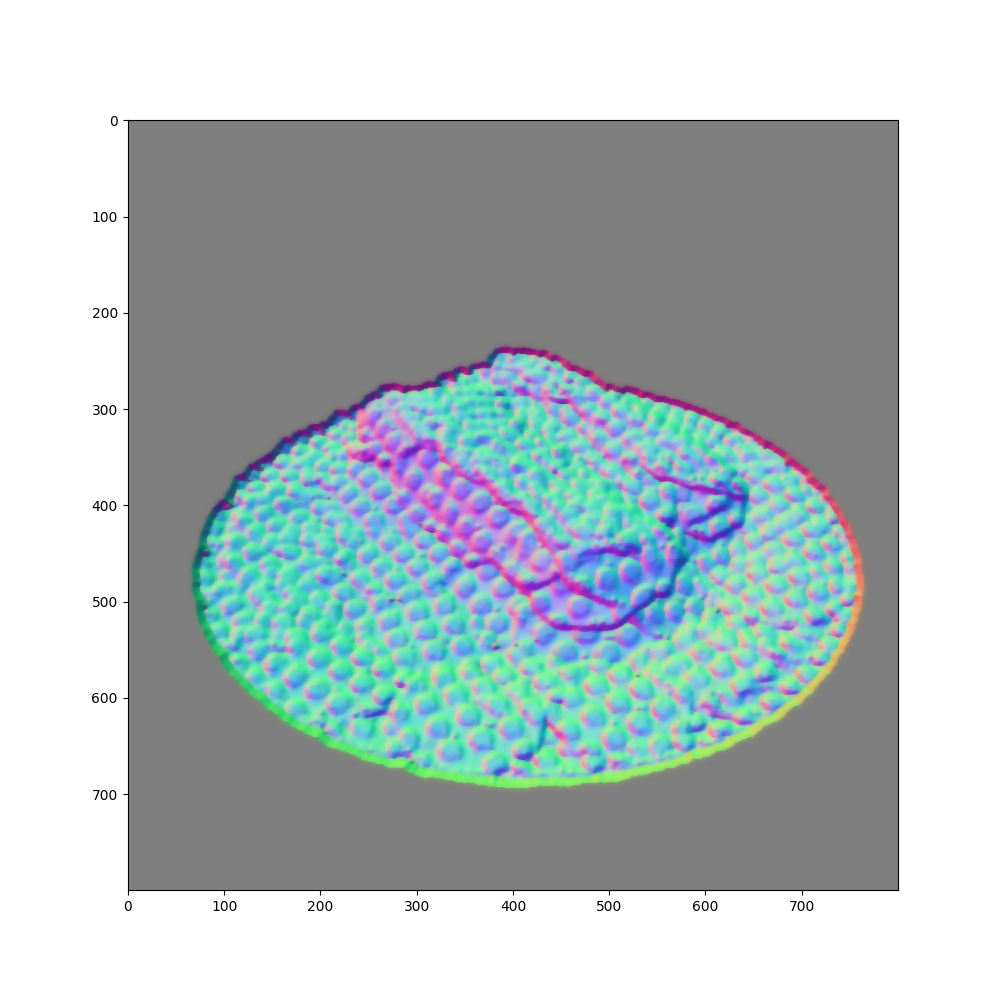

In [834]:
# This one is much more efficient
from skimage.restoration import (denoise_tv_chambolle, denoise_bilateral,
                                 denoise_wavelet, estimate_sigma)
image_normals_np = image_normals.detach().cpu().numpy().transpose(1, 2, 0)

plt.figure(figsize=(10,10))
plt.imshow(denoise_tv_chambolle(image_normals_np, weight=0.3, channel_axis=-1))
plt.show()




In [842]:
def shade_image(img_color, img_normals, 
                drct_lght_color = np.array([1., 1., 1.]), drct_lght_dir = np.array([0., 0., 1.]),
                ambnt_lght=np.array([0.1, 0.1, 0.1]) ):
    """
    Relights the image given by the color of every pixel and its normals. Additionally use the sf
    Implementation is taken from this video https://youtu.be/wOyavGx28uU?t=1084 .
    :param img_color: numpy array of shape [H,W,D] with values in [0,1]
    :param img_normals: numpy array of shape [H,W,D] with values in [0,1] and norm along last dim is 1
    :param 
    
    """
    
    drct_lght_color = np.expand_dims(np.expand_dims(drct_lght_color, axis=0), axis=0)
    ambnt_lght = np.expand_dims(np.expand_dims(ambnt_lght, axis=0), axis=0)
    drct_lght_dir = drct_lght_dir / (1e-6 + np.linalg.norm(drct_lght_dir))
    reflected_light = drct_lght_color * np.expand_dims(np.clip(np.dot(img_normals, drct_lght_dir), 0.,1.), axis=-1)
    #reflected_light = reflected_light / (1e-6 + np.linalg.norm(reflected_light))
    #print(reflected_light)
    #print(np.max(reflected_light))
    color =  img_color * np.clip((reflected_light*(1.-np.max(ambnt_lght))+ambnt_lght) ,0.,1.)
    return color 
    
    
    
    
    

In [836]:
image_normals.detach().cpu().numpy().transpose(1, 2, 0).shape

(800, 800, 3)

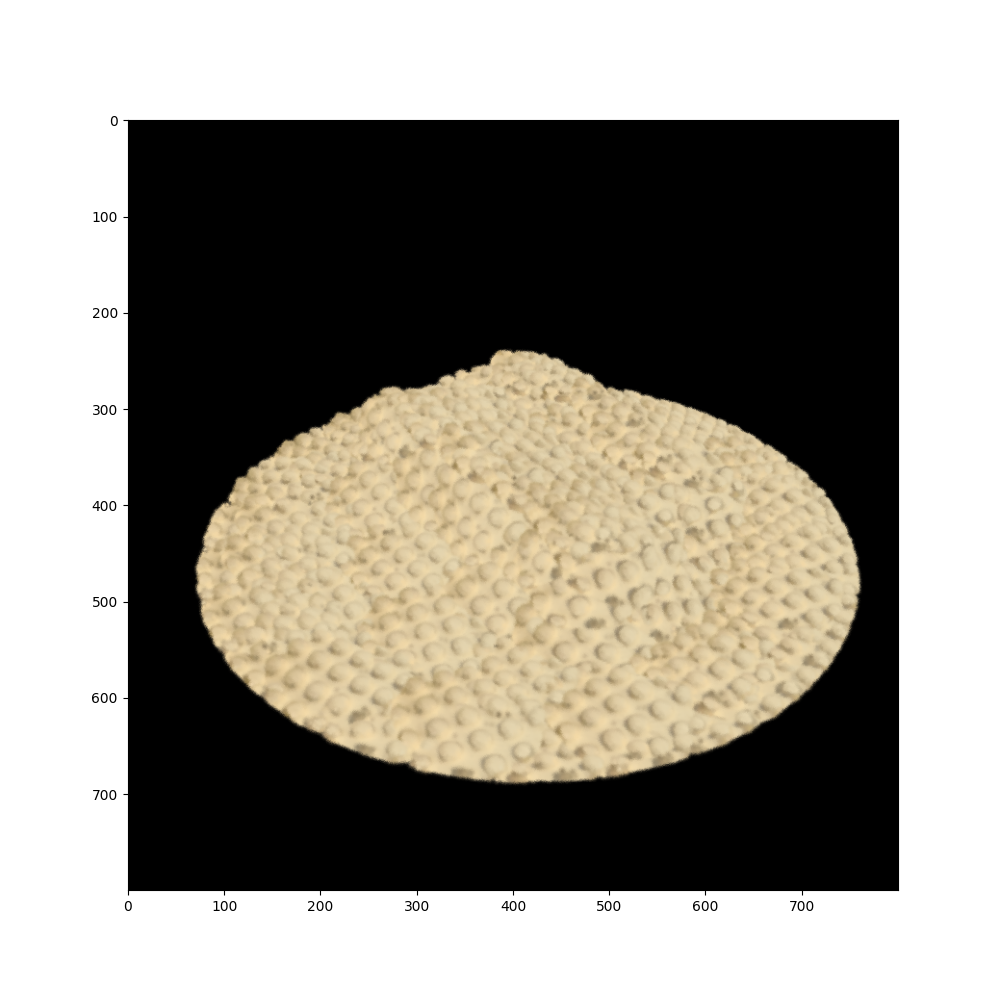

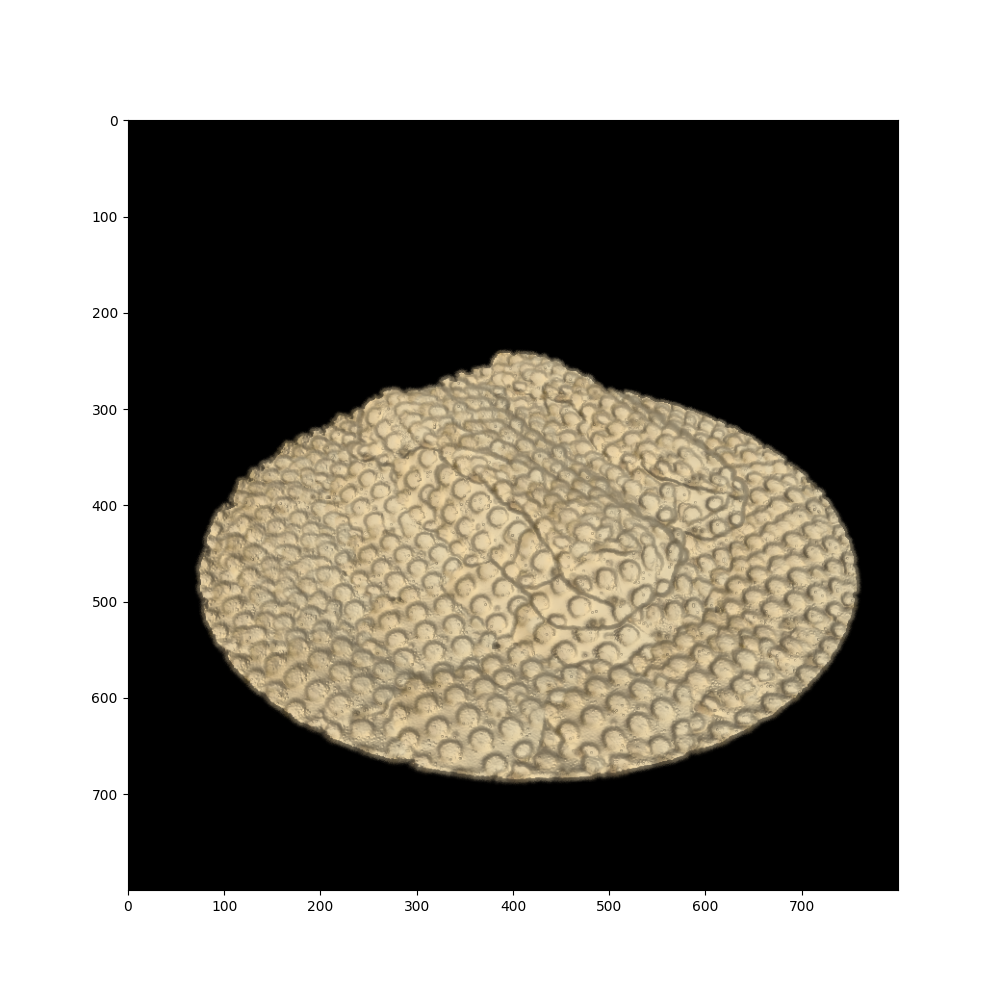

In [837]:
plt.figure(figsize=(10,10))
plt.imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals.detach().cpu().numpy().transpose(1, 2, 0),
                          ambnt_lght=np.array([.1,.1,.1])*0,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])

plt.figure(figsize=(10,10))
plt.imshow(image_shaded)
plt.show()


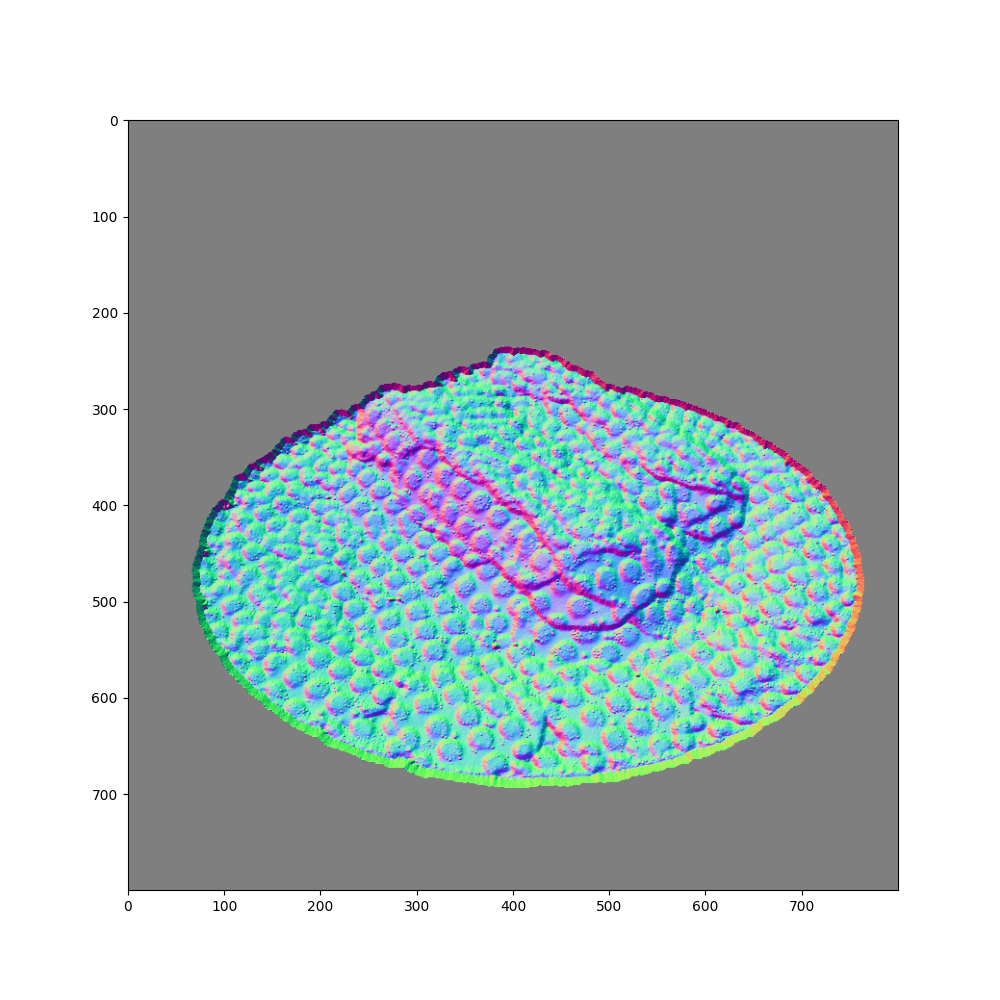

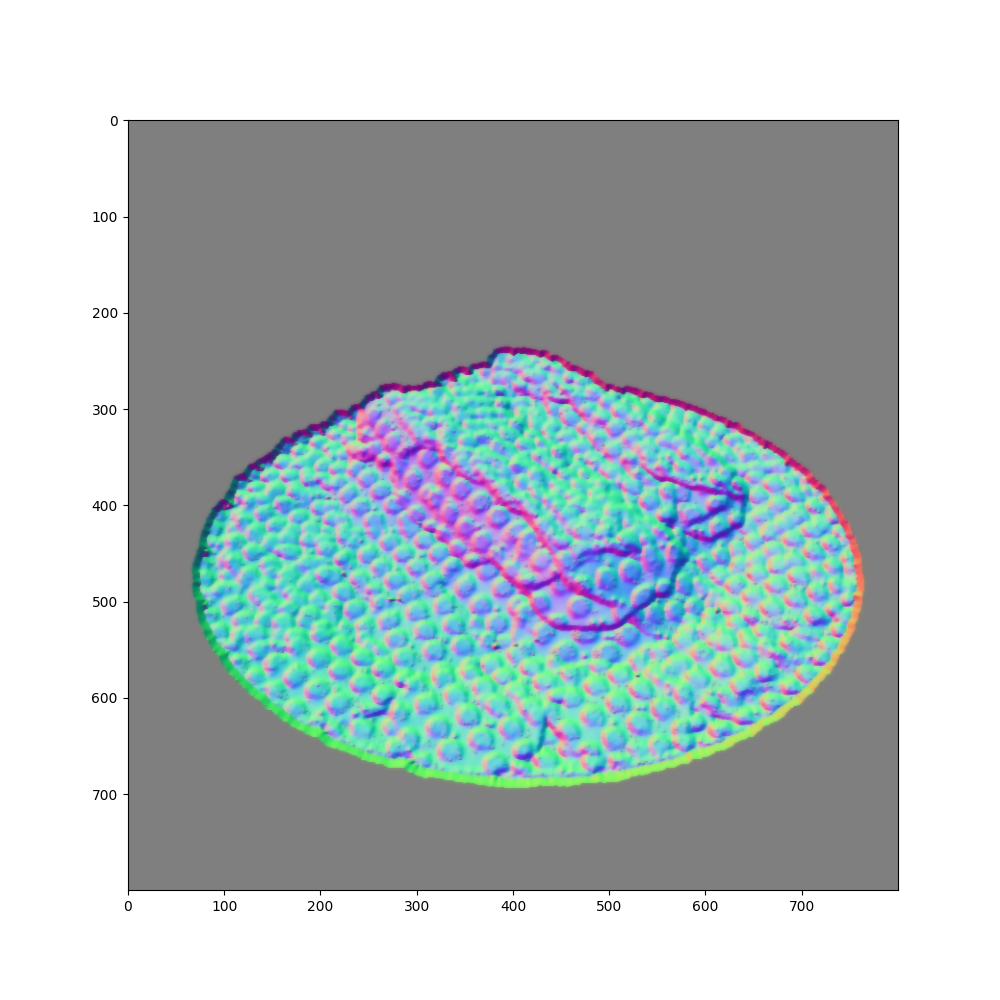

In [904]:
# This one is much more efficient
from skimage.restoration import (denoise_tv_chambolle, denoise_bilateral,
                                 denoise_wavelet, estimate_sigma)
image_normals_np = image_normals.detach().cpu().numpy().transpose(1, 2, 0)


plt.figure(figsize=(10,10))
plt.imshow(image_normals_np)
plt.show()

plt.figure(figsize=(10,10))
plt.imshow(denoise_tv_chambolle(image_normals_np, weight=0.2, channel_axis=-1))
plt.show()






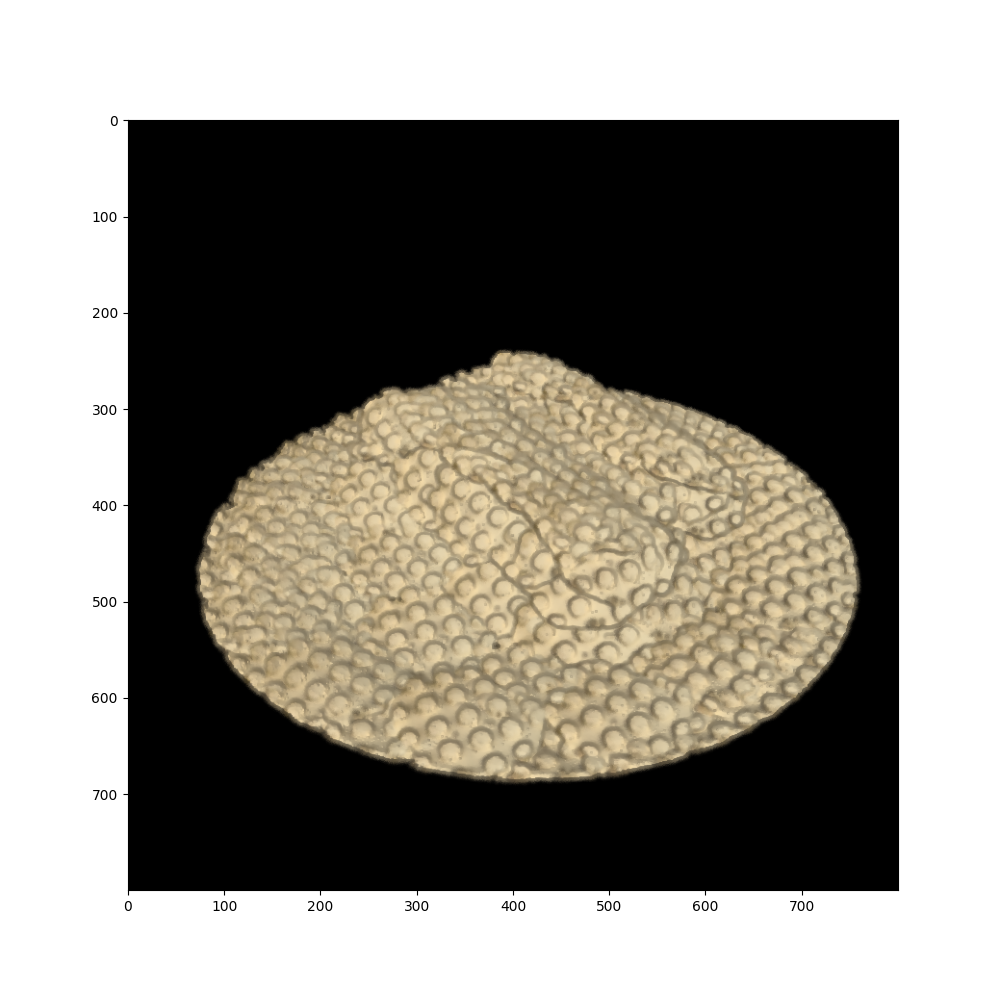

In [922]:
image_normals_denoised = denoise_tv_chambolle(image_normals.detach().cpu().numpy().transpose(1, 2, 0), 
                                              weight=0.05, 
                                              channel_axis=-1)
image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals_denoised,
                          ambnt_lght=np.array([.1,.1,.1])*0.,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])

plt.figure(figsize=(10,10))
plt.imshow(image_shaded)
plt.show()

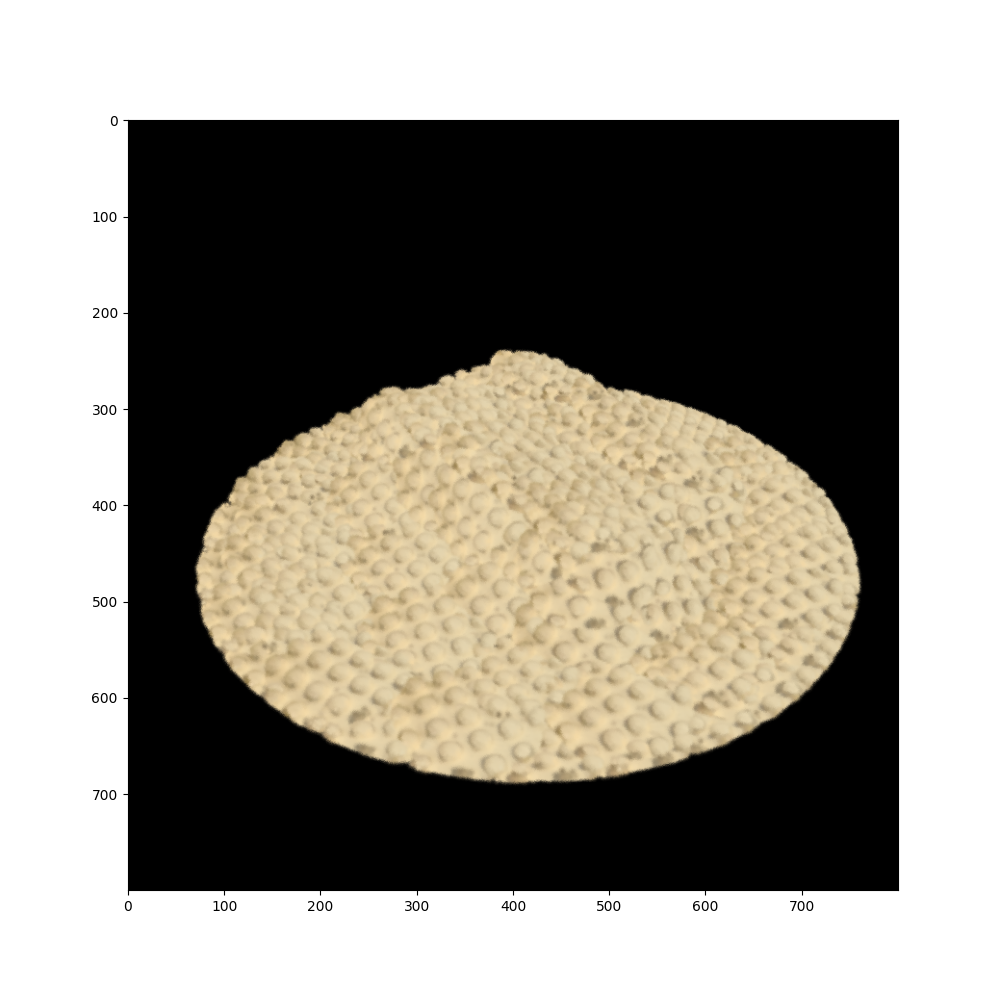

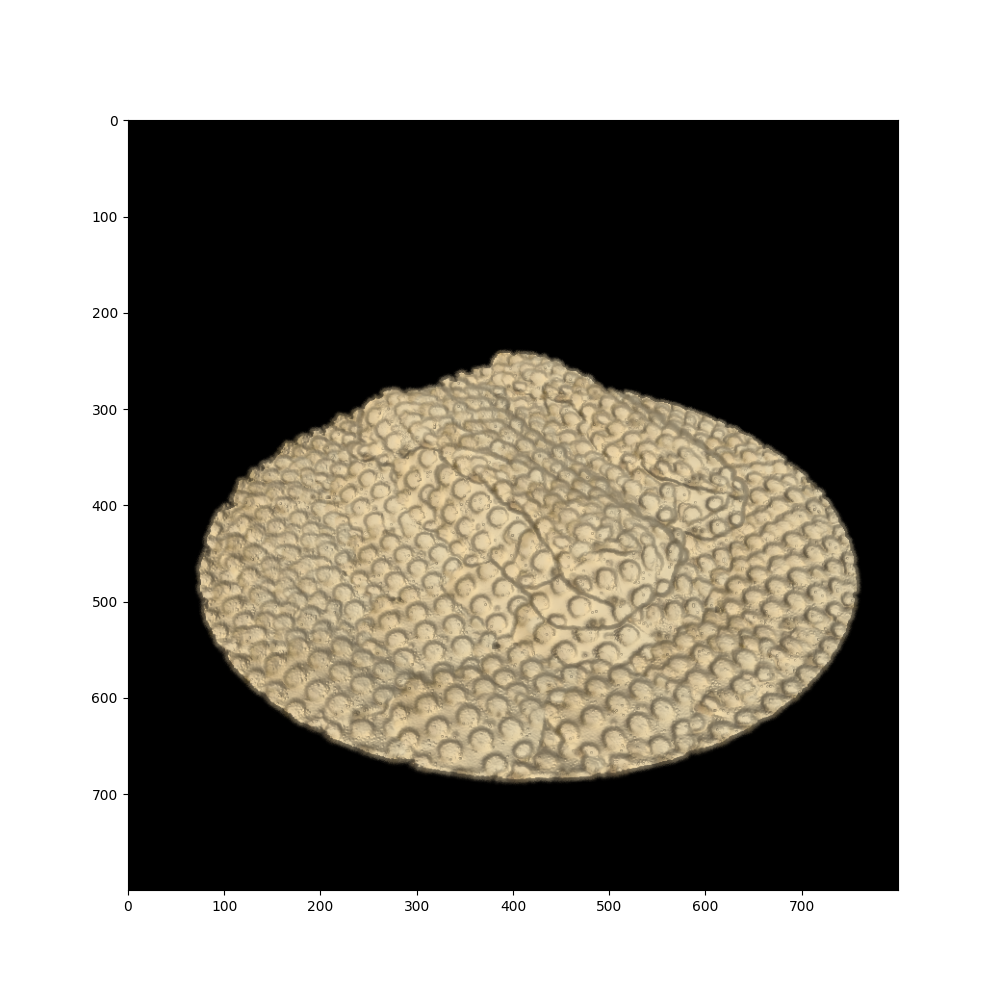

In [896]:
plt.figure(figsize=(10,10))
plt.imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals.detach().cpu().numpy().transpose(1, 2, 0),
                          ambnt_lght=np.array([.1,.1,.1])*0,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])

plt.figure(figsize=(10,10))
plt.imshow(image_shaded)
plt.show()


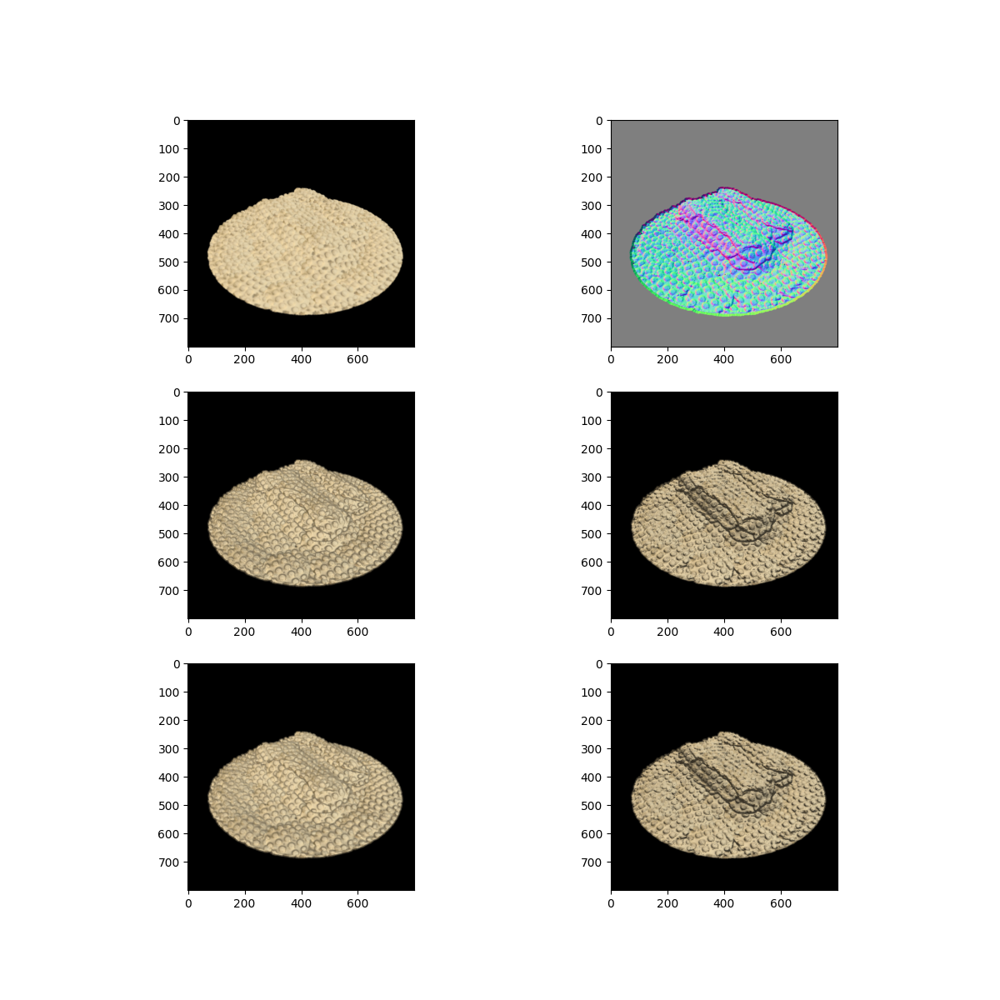

In [875]:


fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(12,12))
ax[0,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[0,1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))


image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals.detach().cpu().numpy().transpose(1, 2, 0),
                          ambnt_lght=np.array([.1,.1,.1])*0,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
ax[1,0].imshow(image_shaded)



image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals_world.detach().cpu().numpy().transpose(1, 2, 0),
                          ambnt_lght=np.array([.1,.1,.1])*3,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
ax[1,1].imshow(image_shaded)




image_normals_blurred = image_normals.detach().cpu().numpy().transpose(1, 2, 0)
image_normals_blurred = denoise_tv_chambolle(image_normals_blurred, weight=0.05, channel_axis=-1)

image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals_blurred,
                          ambnt_lght=np.array([.1,.1,.1])*0,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
ax[2,0].imshow(image_shaded)



image_normals_blurred = image_normals_world.detach().cpu().numpy().transpose(1, 2, 0)
image_normals_blurred = denoise_tv_chambolle(image_normals_blurred, weight=0.05, channel_axis=-1)
image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals_blurred,
                          ambnt_lght=np.array([.1,.1,.1])*3,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
ax[2,1].imshow(image_shaded)


plt.show()

In [877]:

img_color = image.detach().cpu().numpy().transpose(1, 2, 0)
img_color_ = np.concatenate(img_color, axis=0)
#img_color_median = np.median(img_color[img_color>0.01], axi)

img_median_color = np.median(img_color_[np.max(img_color_, axis=-1)>0], axis=0, keepdims=True)

img_color = image.detach().cpu().numpy().transpose(1, 2, 0)
img_color[np.where(np.max(img_color, axis=-1)>0)] = img_median_color

#print(img_color_median)

In [878]:
np.where(np.max(img_color, axis=-1)>0)

(array([236, 236, 236, ..., 692, 692, 692]),
 array([390, 392, 394, ..., 414, 415, 416]))

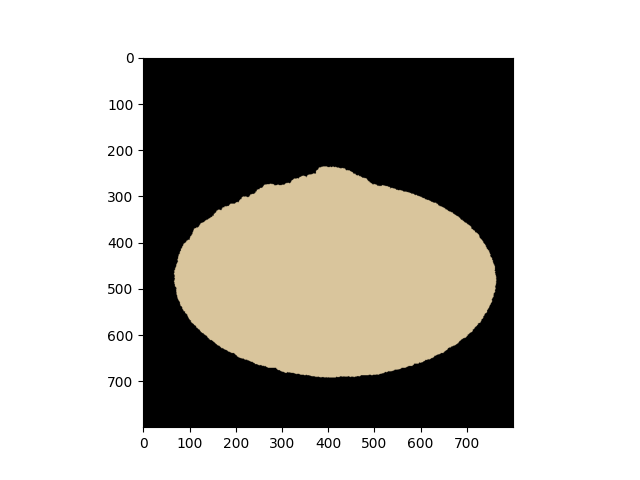

In [879]:
plt.figure()
plt.imshow(img_color)
plt.show()

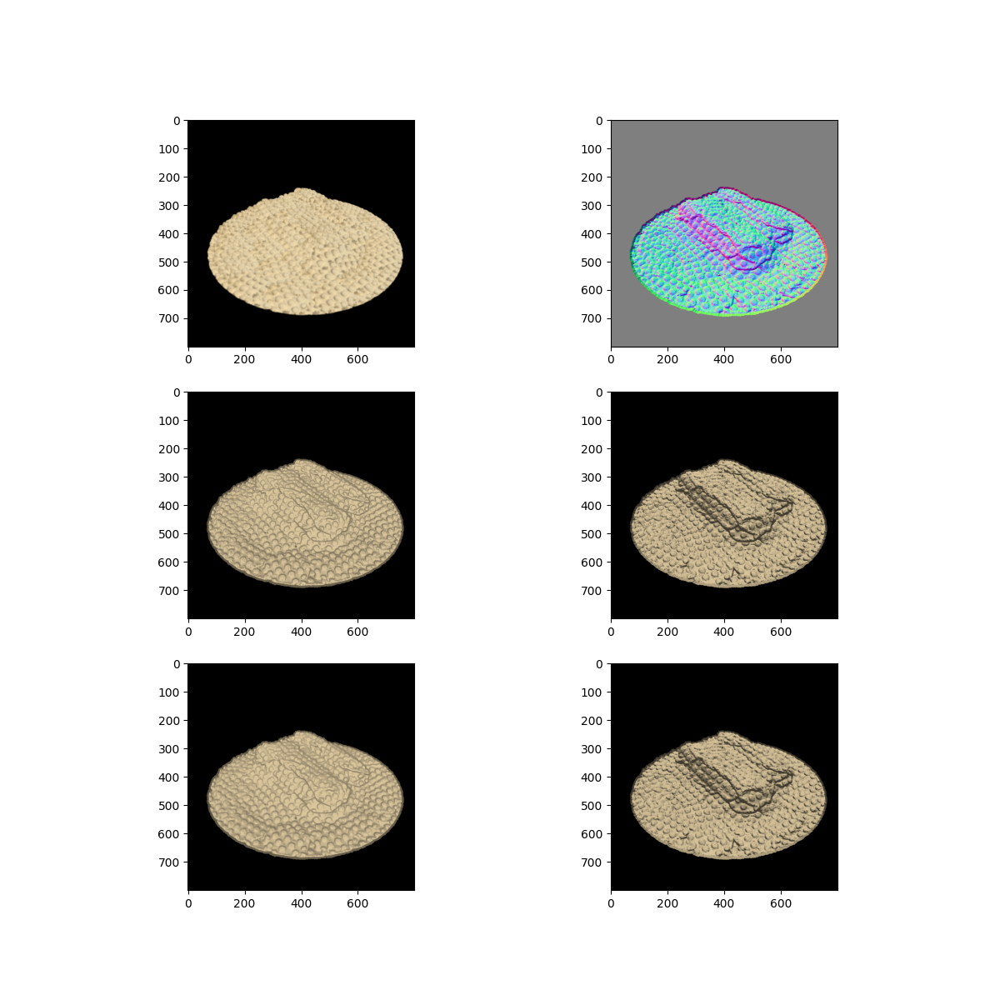

In [880]:


fig, ax = plt.subplots(nrows=3, ncols=2, figsize=(12,12))
ax[0,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[0,1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))


image_shaded = shade_image(img_color=img_color,
            img_normals=image_normals.detach().cpu().numpy().transpose(1, 2, 0),
                          ambnt_lght=np.array([.1,.1,.1])*0,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
ax[1,0].imshow(image_shaded)



image_shaded = shade_image(img_color=img_color,
            img_normals=image_normals_world.detach().cpu().numpy().transpose(1, 2, 0),
                          ambnt_lght=np.array([.1,.1,.1])*3,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
ax[1,1].imshow(image_shaded)




image_normals_blurred = image_normals.detach().cpu().numpy().transpose(1, 2, 0)
image_normals_blurred = denoise_tv_chambolle(image_normals_blurred, weight=0.05, channel_axis=-1)

image_shaded = shade_image(img_color=img_color,
            img_normals=image_normals_blurred,
                          ambnt_lght=np.array([.1,.1,.1])*0,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
ax[2,0].imshow(image_shaded)



image_normals_blurred = image_normals_world.detach().cpu().numpy().transpose(1, 2, 0)
image_normals_blurred = denoise_tv_chambolle(image_normals_blurred, weight=0.05, channel_axis=-1)
image_shaded = shade_image(img_color=img_color,
            img_normals=image_normals_blurred,
                          ambnt_lght=np.array([.1,.1,.1])*3,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
ax[2,1].imshow(image_shaded)


plt.show()

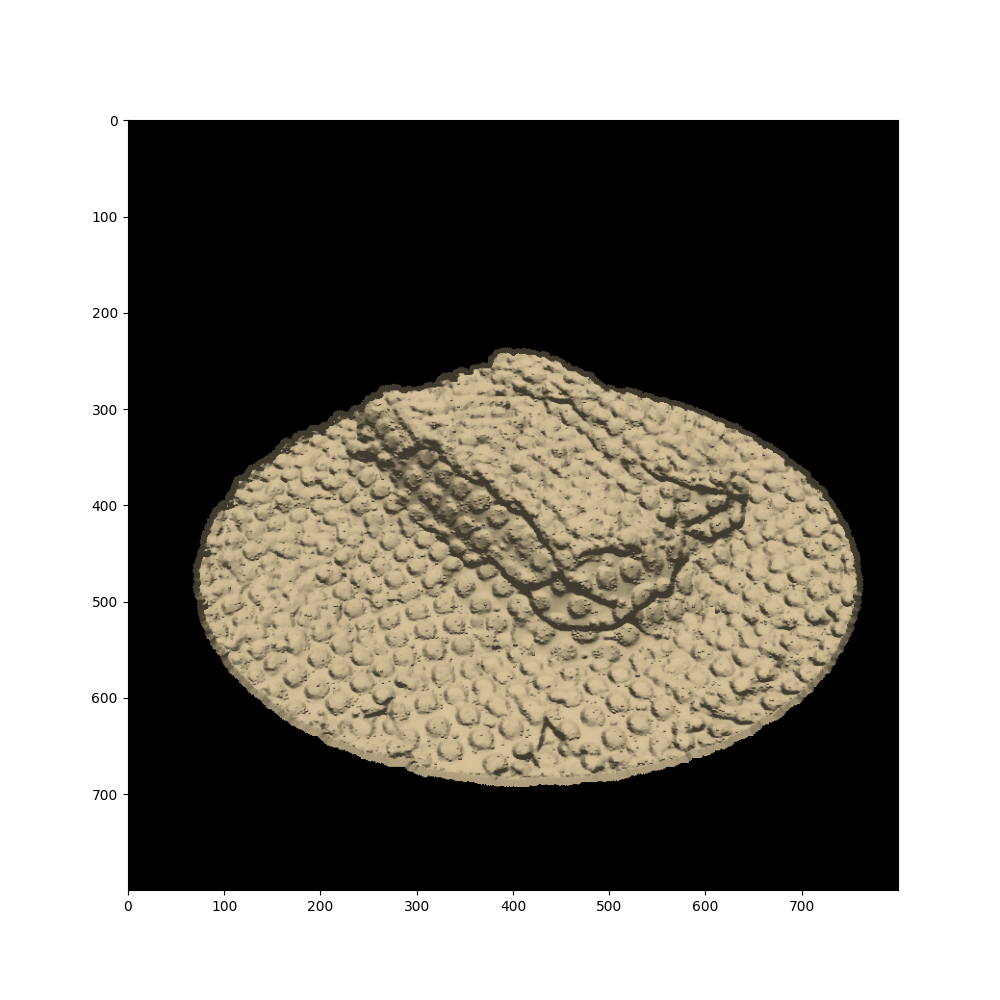

In [884]:
plt.figure(figsize=(10,10))


image_normals_blurred = image_normals.detach().cpu().numpy().transpose(1, 2, 0)
image_normals_blurred = denoise_tv_chambolle(image_normals_blurred, weight=0.05, channel_axis=-1)

image_shaded = shade_image(img_color=img_color,
            img_normals=image_normals_blurred,
                          ambnt_lght=np.array([.1,.1,.1])*0,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])



image_normals_blurred = image_normals_world.detach().cpu().numpy().transpose(1, 2, 0)
image_normals_blurred = denoise_tv_chambolle(image_normals_blurred, weight=0.05, channel_axis=-1)
image_shaded = shade_image(img_color=img_color,
            img_normals=image_normals_blurred,
                          ambnt_lght=np.array([.1,.1,.1])*3,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])
plt.imshow(image_shaded)
plt.show()

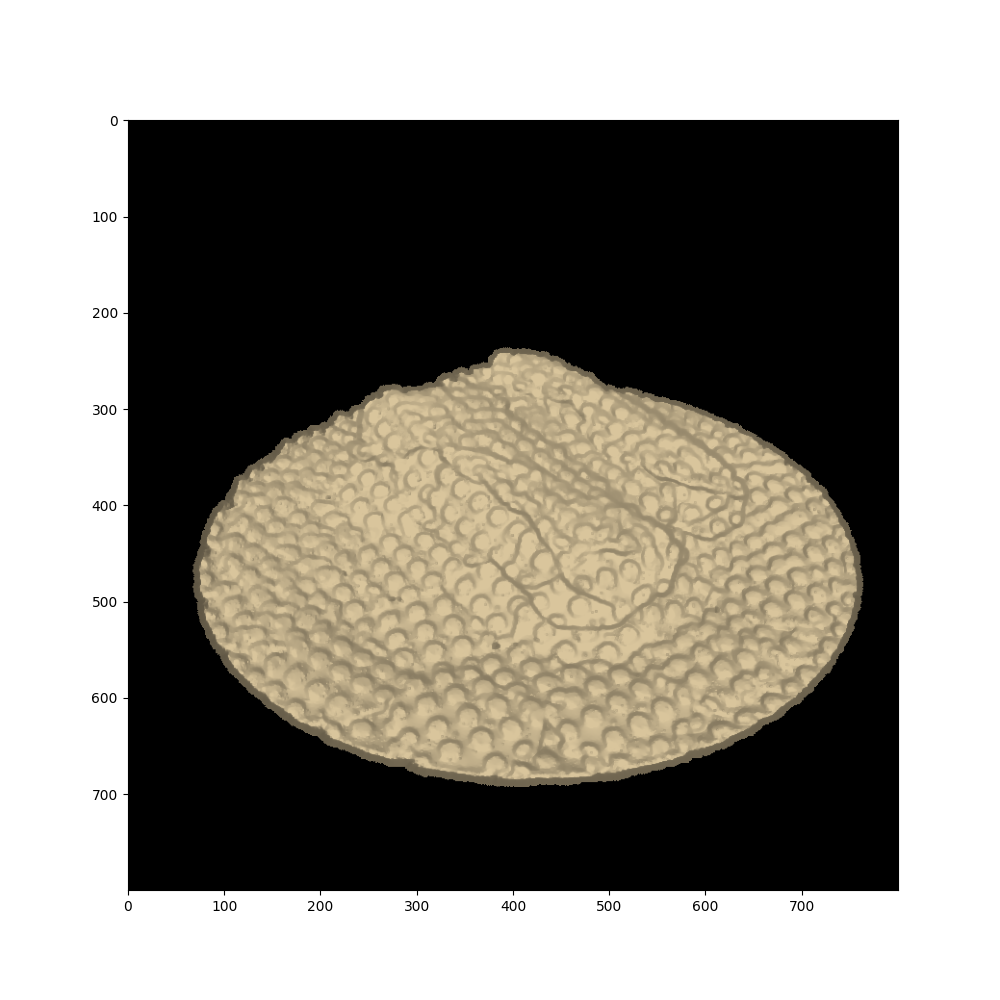

In [876]:


image_normals_np = image_normals.detach().cpu().numpy().transpose(1, 2, 0)
image_normals_np = denoise_tv_chambolle(image_normals_np, weight=0.05, channel_axis=-1)



img_color = image.detach().cpu().numpy().transpose(1, 2, 0)
img_color_ = np.concatenate(img_color, axis=0)
#img_color_median = np.median(img_color[img_color>0.01], axi)

img_median_color = np.median(img_color_[np.max(img_color_, axis=-1)>0], axis=0, keepdims=True)

img_color = image.detach().cpu().numpy().transpose(1, 2, 0)
img_color[np.where(np.max(img_color, axis=-1)>0)] = img_median_color

image_shaded = shade_image(img_color=img_color,
            img_normals=image_normals_np,
                         ambnt_lght=np.array([.1,.1,.1])*0.5,
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [.2, .3, 3.6])

plt.figure(figsize=(10,10))
plt.imshow(image_shaded)
plt.show()

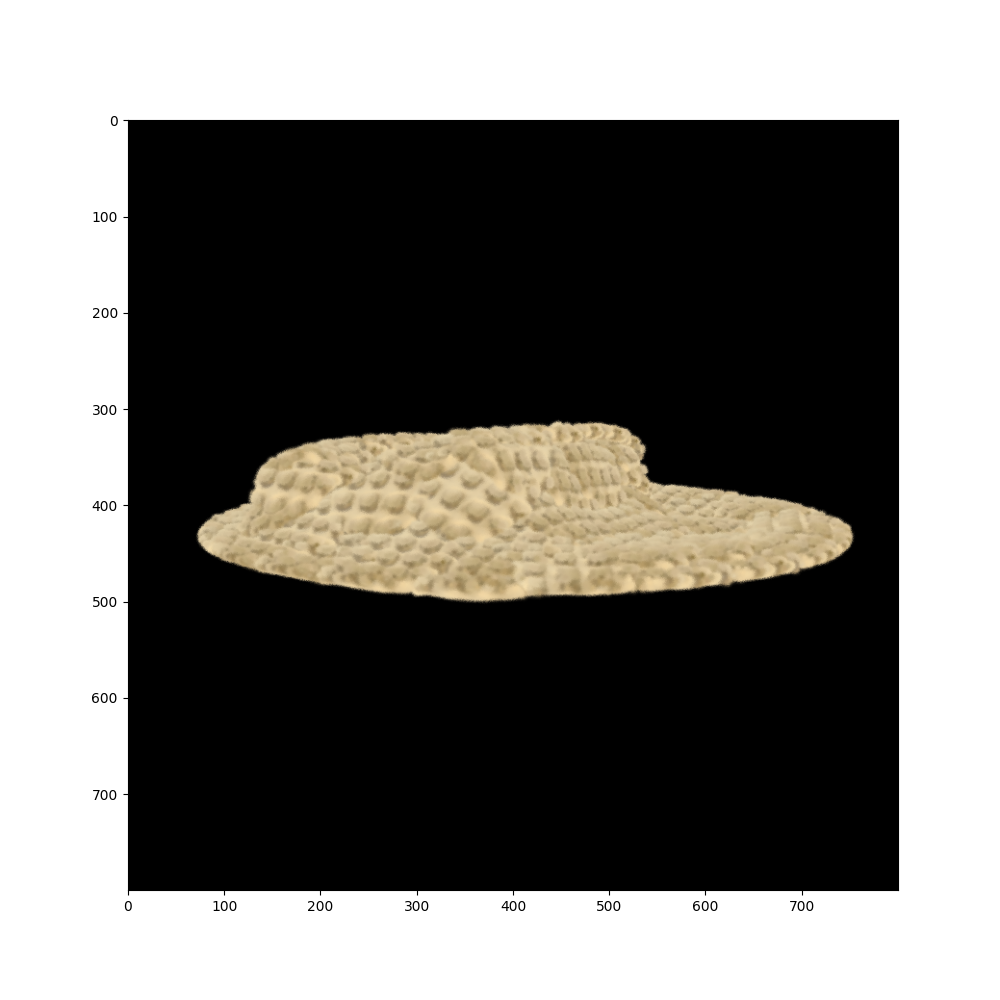

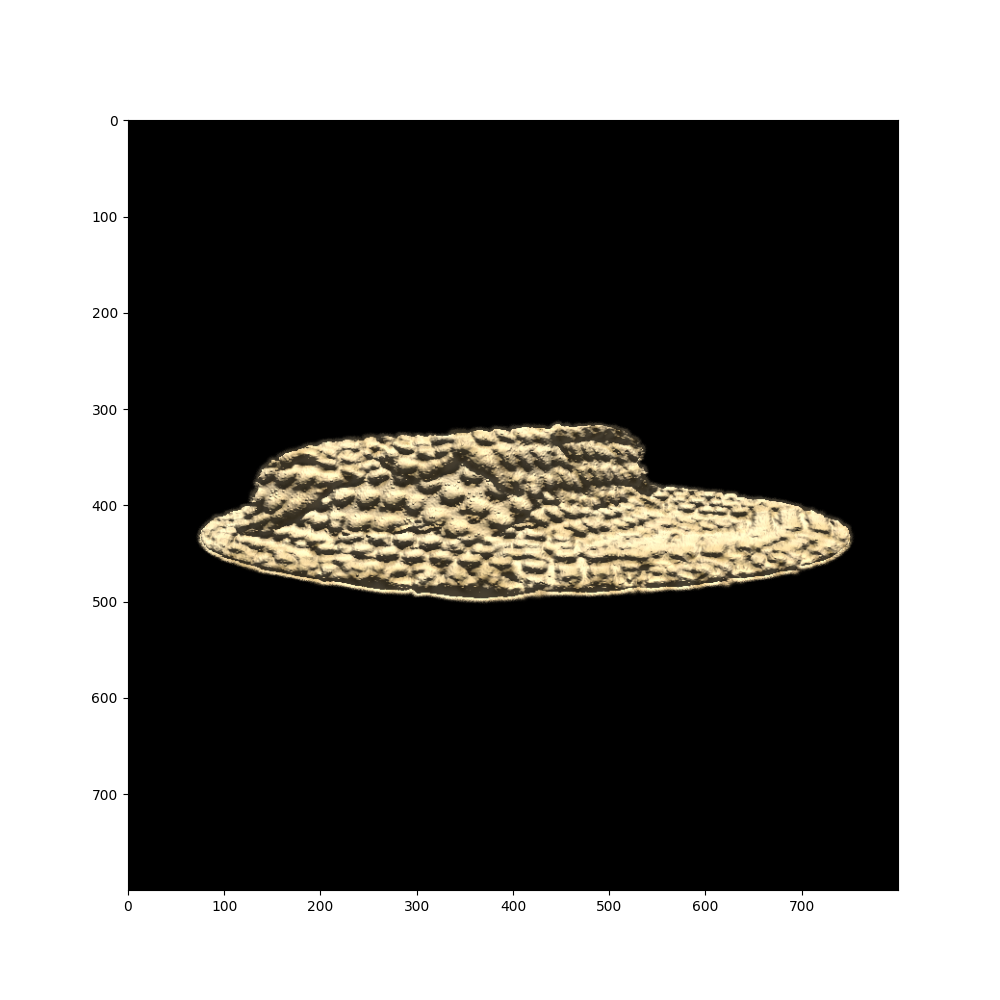

In [734]:
plt.figure(figsize=(10,10))
plt.imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals.detach().cpu().numpy().transpose(1, 2, 0),
                          ambnt_lght=[.3,.3,.3],
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [-.2, -.3, 3.6])

plt.figure(figsize=(10,10))
plt.imshow(image_shaded)
plt.show()

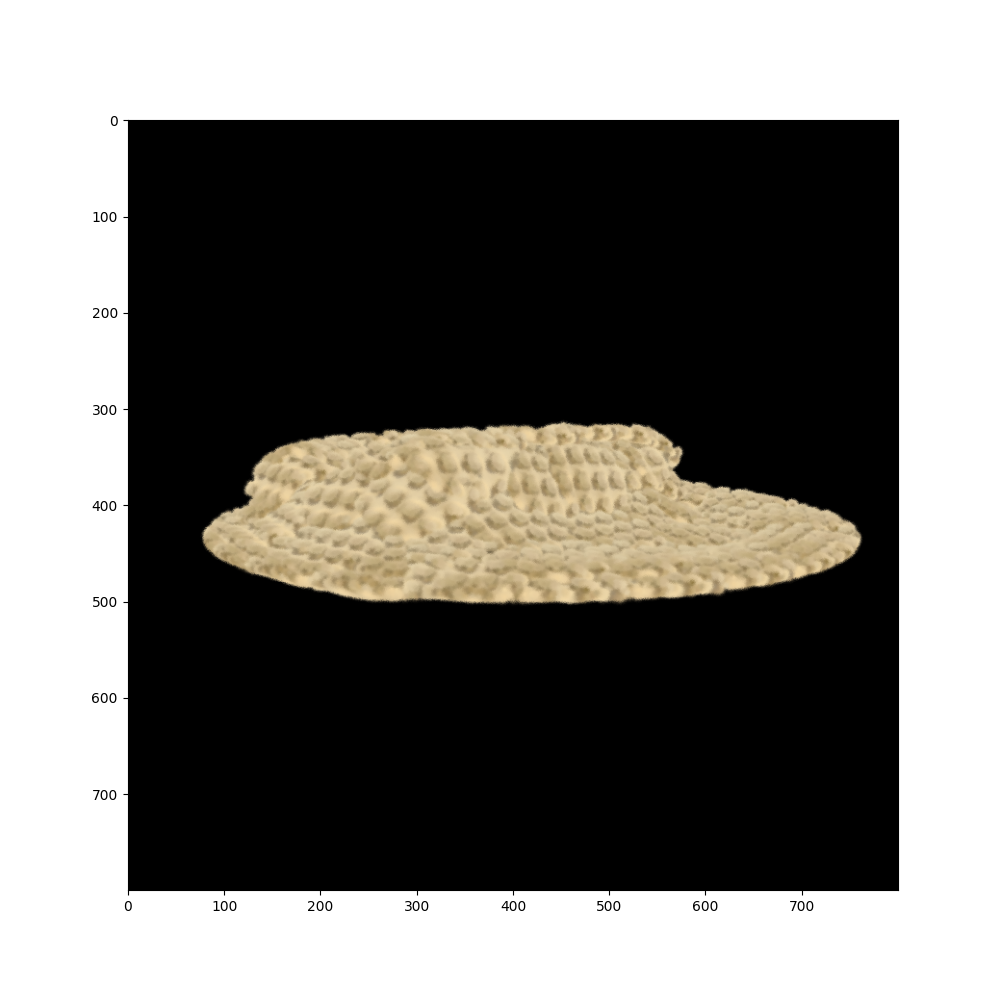

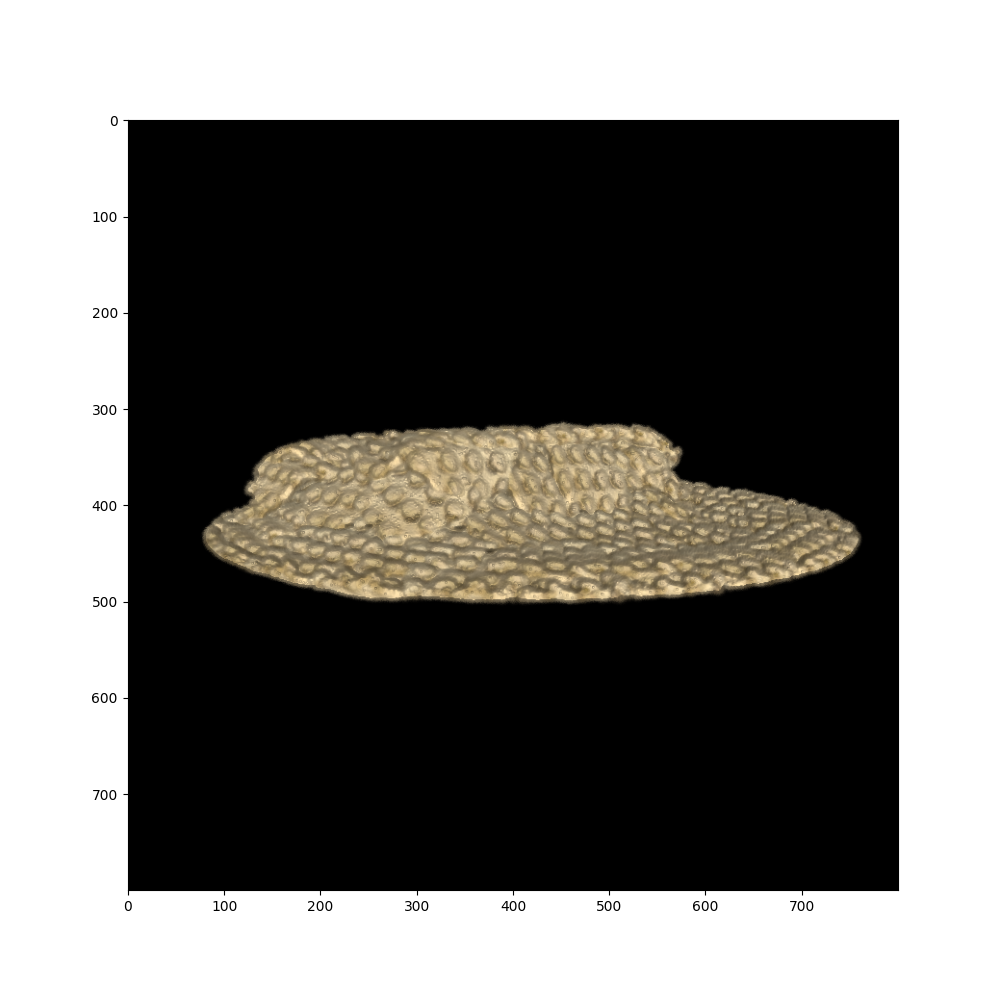

In [392]:
plt.figure(figsize=(10,10))
plt.imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals.detach().cpu().numpy().transpose(1, 2, 0),
                          ambnt_lght=[.2,.2,.2],
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [-.2, -.3, 2.6])

plt.figure(figsize=(10,10))
plt.imshow(image_shaded)
plt.show()

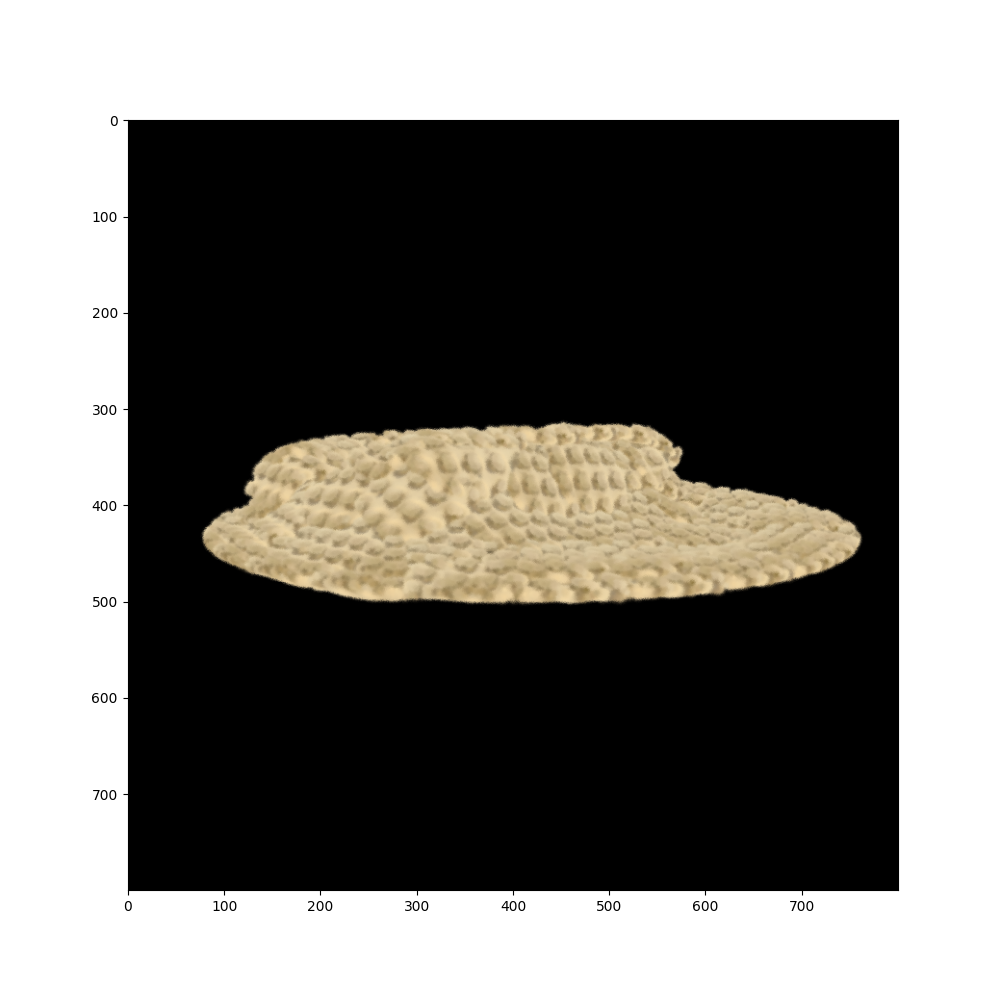

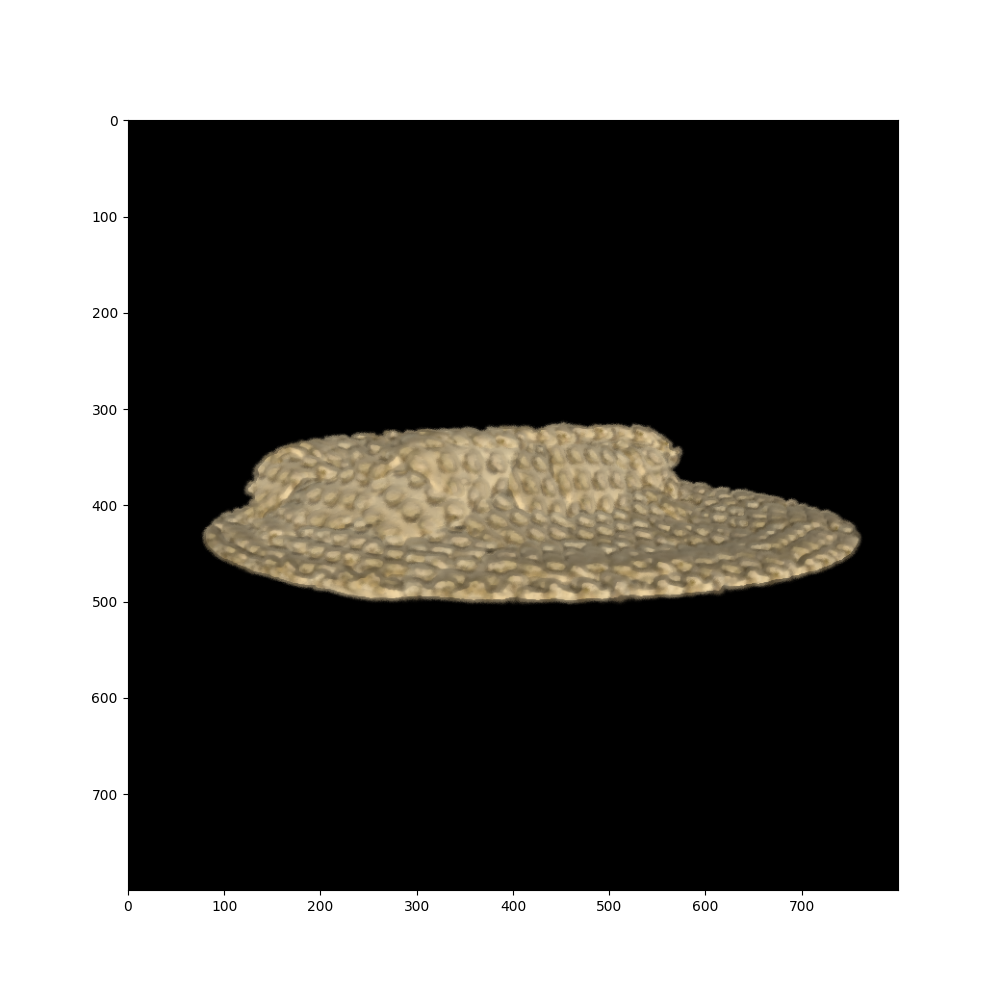

In [393]:
plt.figure(figsize=(10,10))
plt.imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()


image_normals_np = image_normals.detach().cpu().numpy().transpose(1, 2, 0)
image_normals_np = denoise_tv_chambolle(image_normals_np, weight=0.1, channel_axis=-1)
image_shaded = shade_image(img_color=image.detach().cpu().numpy().transpose(1, 2, 0),
            img_normals=image_normals_np,
                          ambnt_lght=[.2,.2,.2],
                          drct_lght_color=[1., 1., 1.],
                          drct_lght_dir = [-.2, -.3, 2.6])


plt.figure(figsize=(10,10))
plt.imshow(image_shaded)
plt.show()

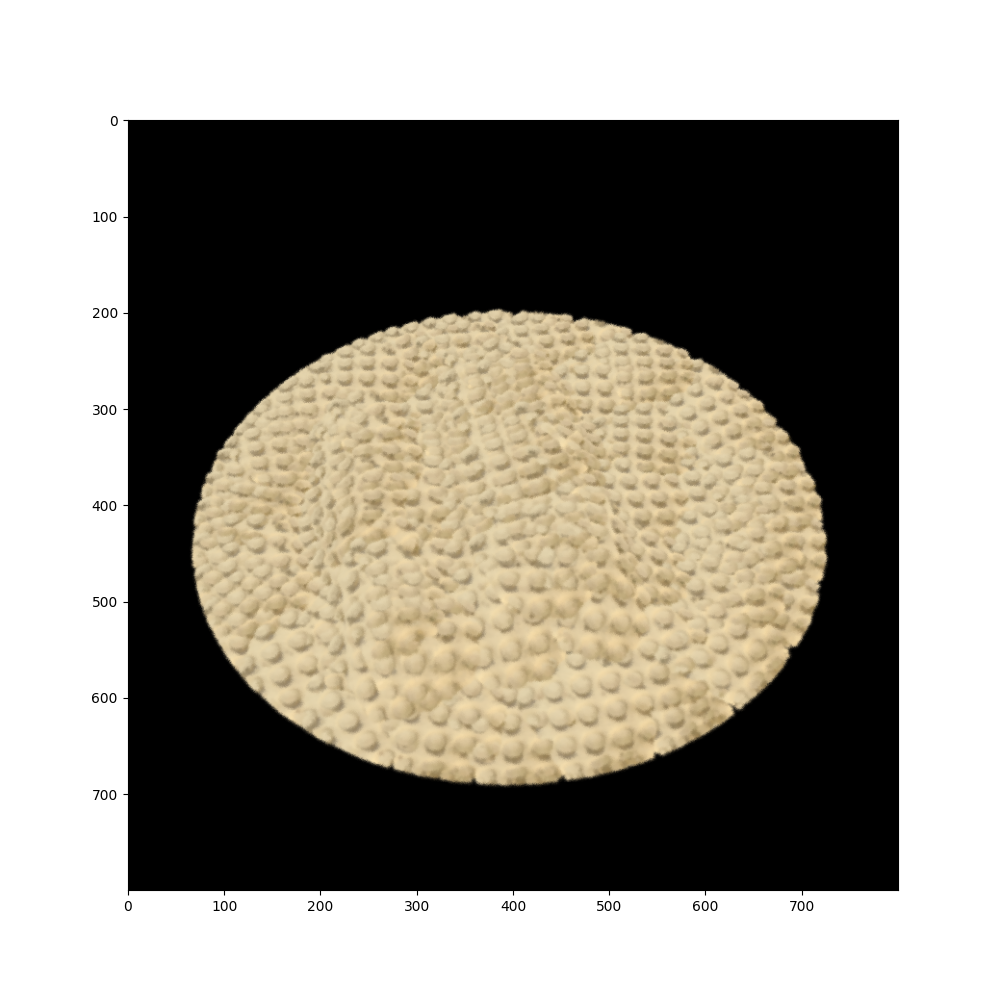

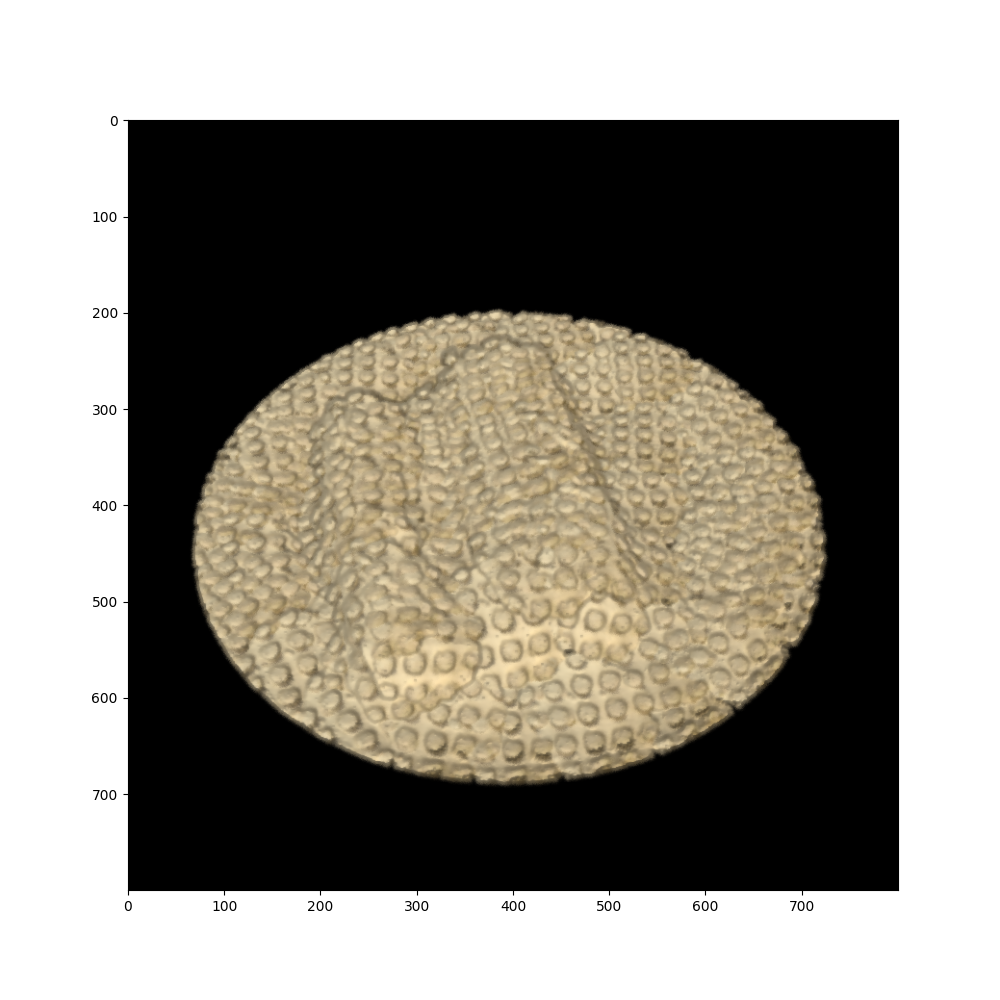

In [384]:
plt.figure(figsize=(10,10))
plt.imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()


plt.figure(figsize=(10,10))
plt.imshow(image_shaded)
plt.show()

In [891]:
list(np.random.rand(3))

[0.11732850162063158, 0.21919696547394207, 0.6056929625332823]

In [895]:
torch.sqrt(torch.tensor(4.))

tensor(2.)

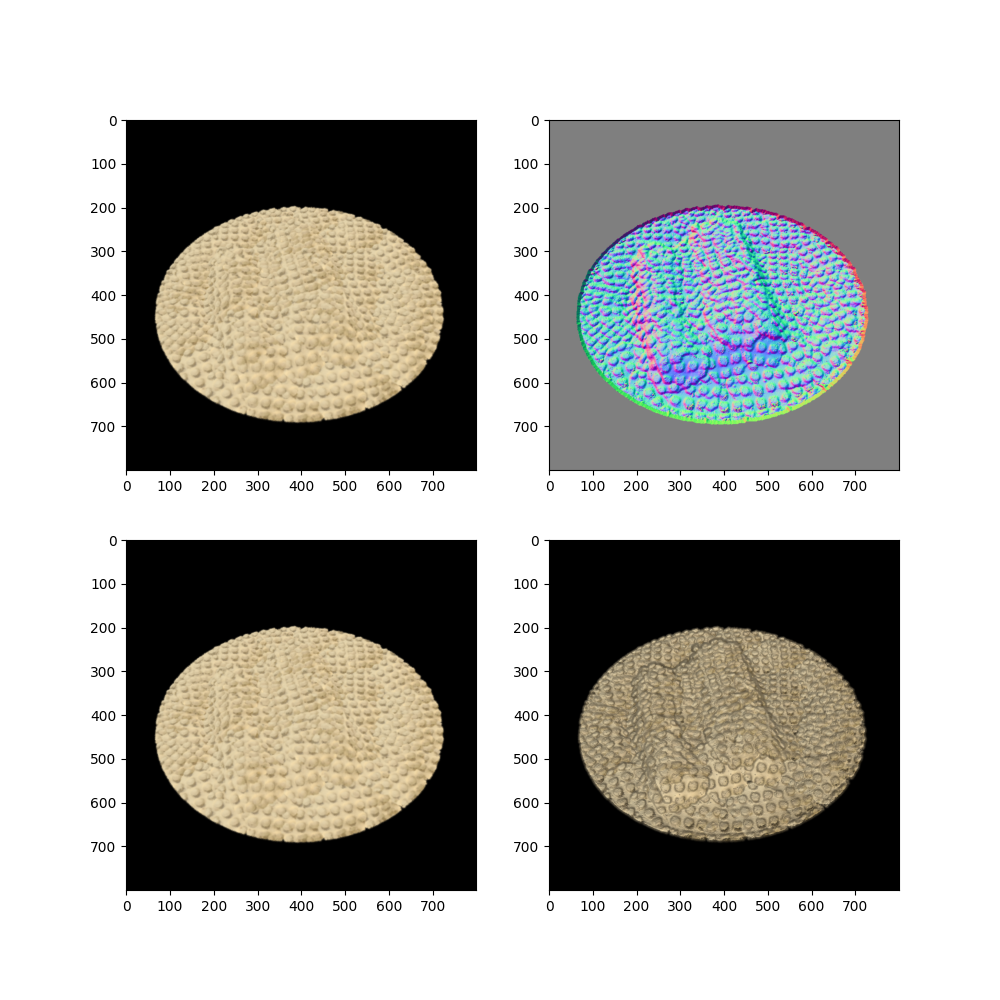

In [350]:

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(10,10))
ax[0,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[0,1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
ax[1,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1,1].imshow(image_shaded)
plt.show()

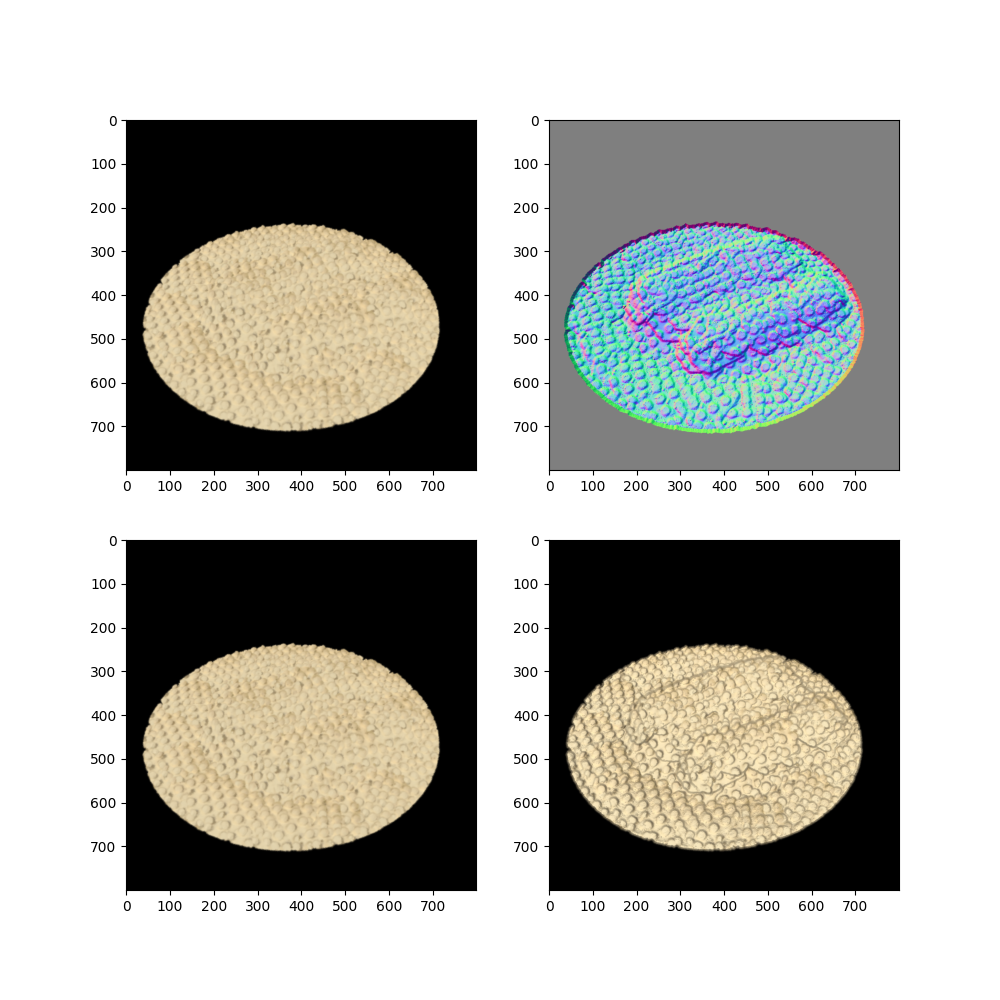

In [311]:

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(10,10))
ax[0,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[0,1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
ax[1,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1,1].imshow(image_shaded)
plt.show()

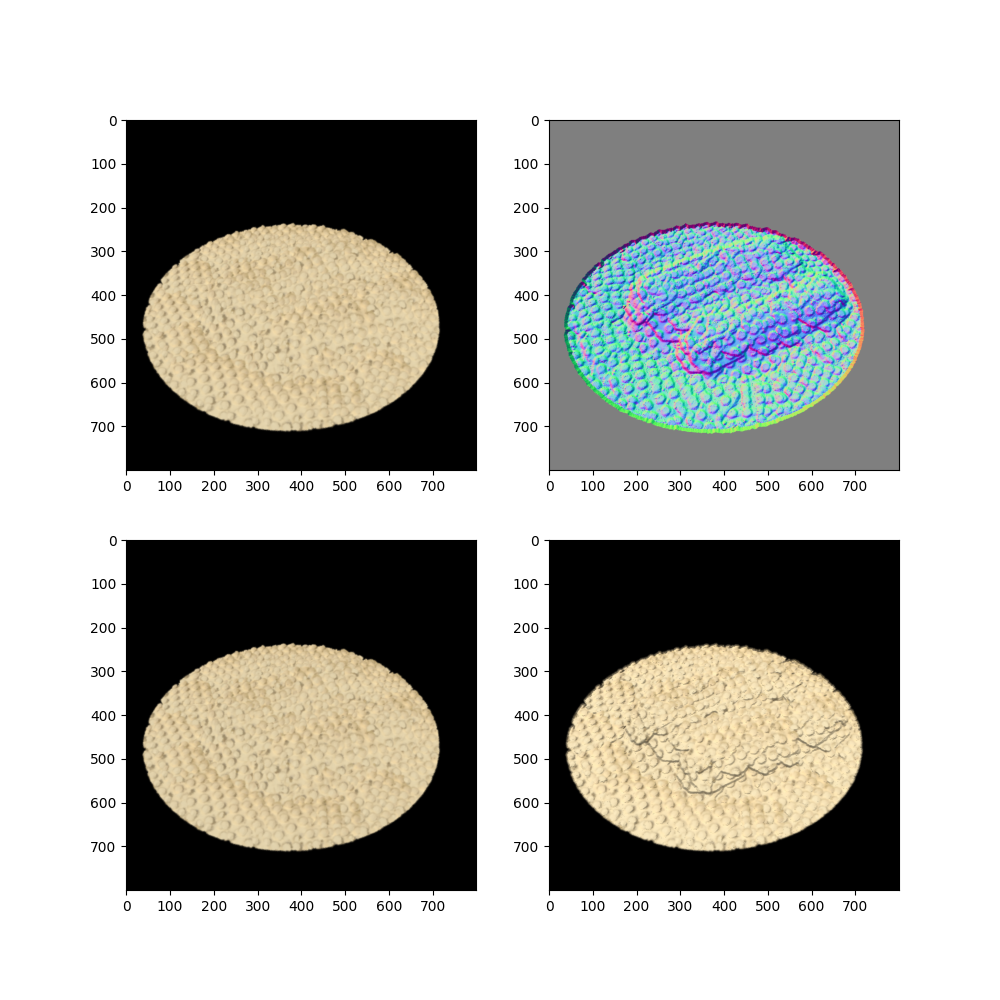

In [315]:

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(10,10))
ax[0,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[0,1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
ax[1,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1,1].imshow(image_shaded)
plt.show()

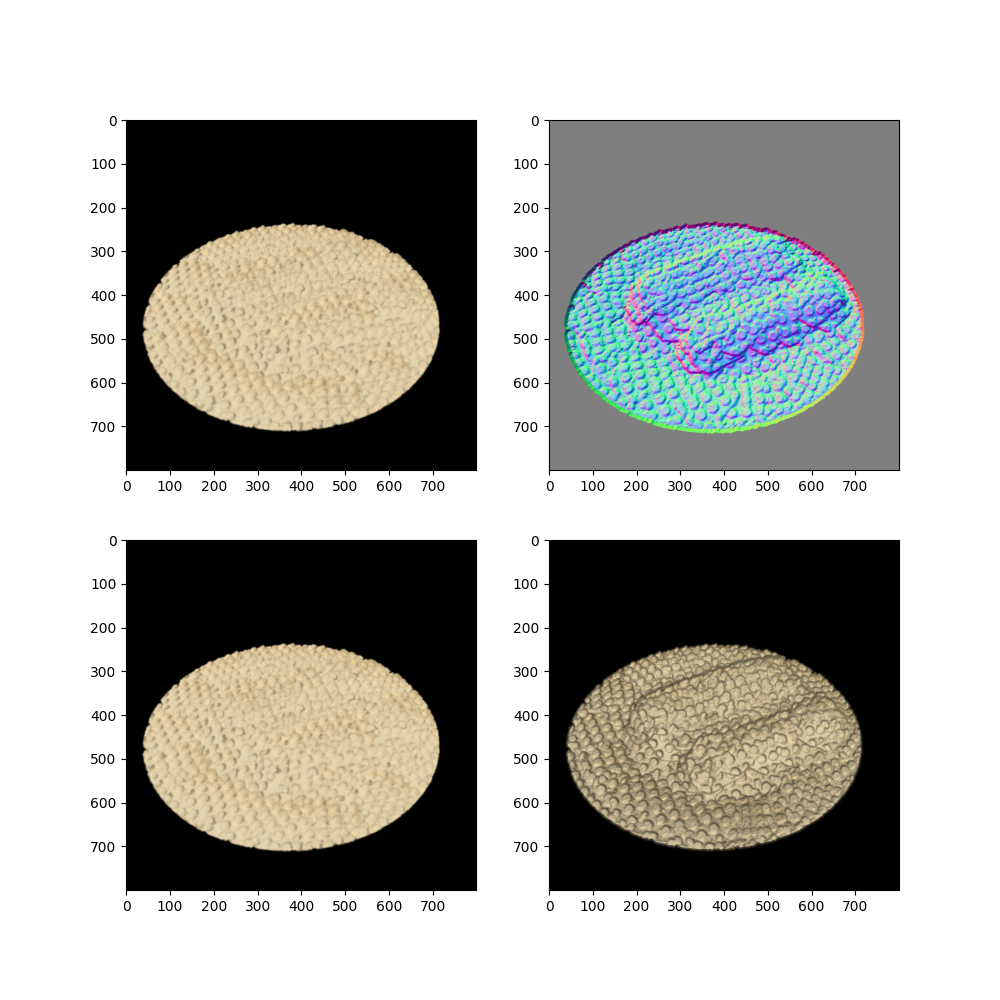

In [323]:

fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(10,10))
ax[0,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[0,1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
ax[1,0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1,1].imshow(image_shaded)
plt.show()

In [180]:
normals.shape

torch.Size([1, 3, 800, 800])

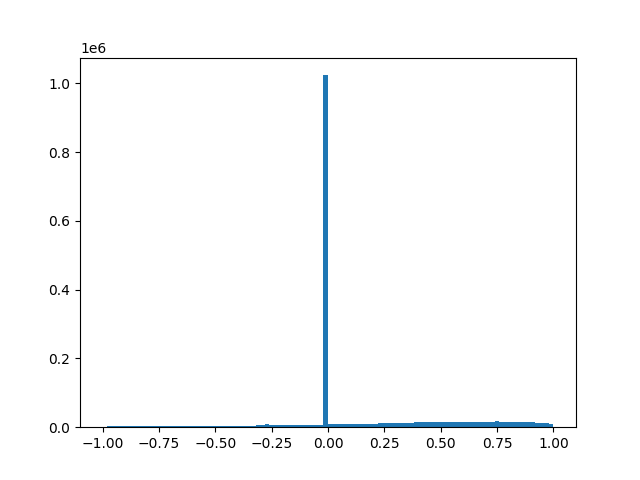

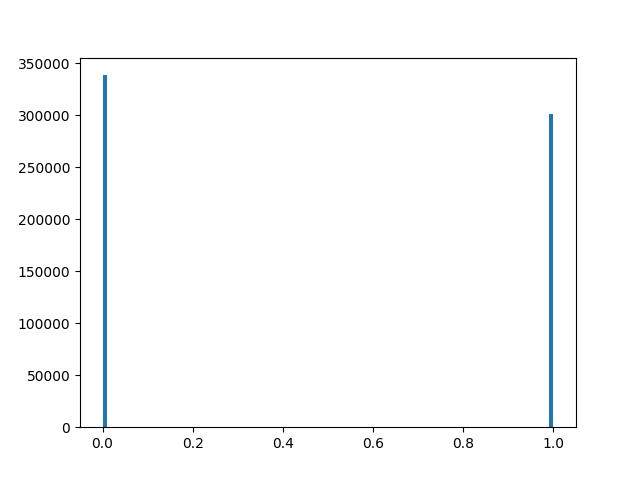

In [186]:
plt.figure()
plt.hist(normals.detach().cpu().numpy().flatten(), bins=100)
plt.show()

plt.figure()
plt.hist(np.linalg.norm(normals.squeeze(0).detach().cpu().numpy(), axis=0).flatten(), bins=100)
plt.show()

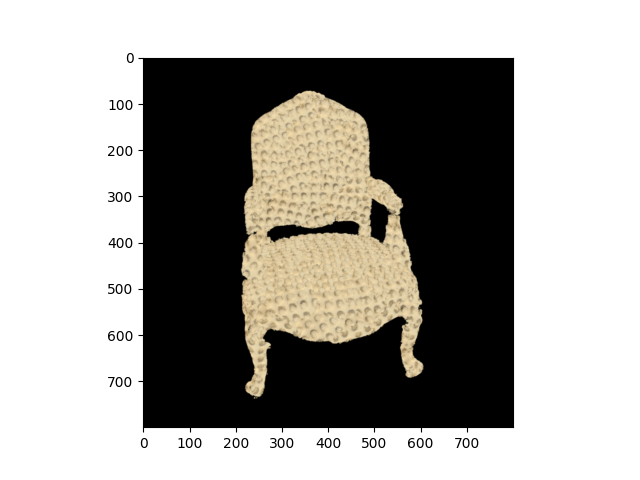

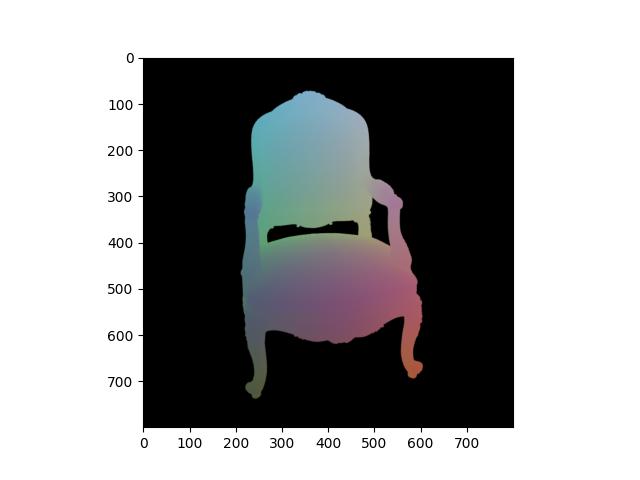

In [127]:


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth_cont.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()

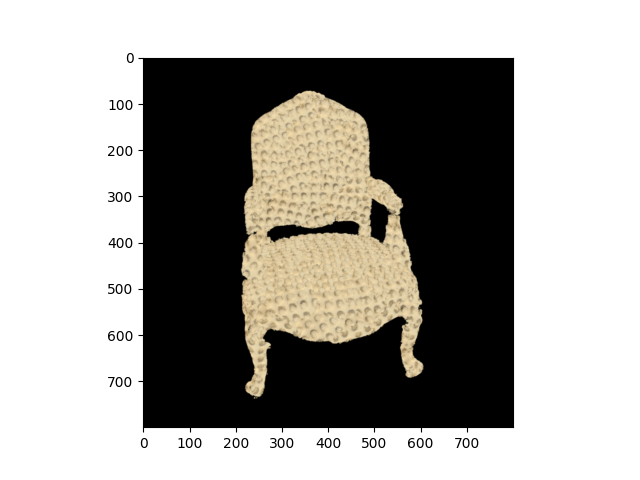

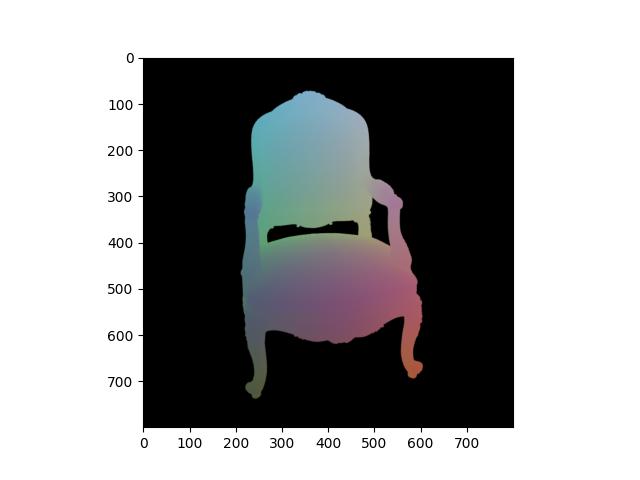

In [142]:


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth_cont.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()

NameError: name 'kornia' is not defined

In [ ]:
gaussians_opt._features_dc.data = gaussians_opt_features_dc_fitted.clone()

In [923]:
! ls .

10.visualize_and_fit_patch_to_multiple.ipynb
11.fit_cluster_to_the_full_scene.ipynb
12.visualize_fitted_model_results.ipynb
13.Optimize_guassians_depth.ipynb
14.Fit_many_clusters.ipynb
15.Fit_many_clusters_percep_loss_2.ipynb
15.Fit_many_clusters_percep_loss_3.ipynb
15.Fit_many_clusters_percep_loss.ipynb
16.Blend_scenes_in_latent_space.ipynb
17.Optimize_depth.ipynb
18.Fit_coarse.ipynb
19.Fit_single_cluster.ipynb
20.Fit_to_mesh.ipynb
cat_doodle.jpeg
clusters.npz
dummy_scene
GT_lego_cluster2_test_notebook14
test_3D_vis.ipynb
test_EMD_local_stats.ipynb
test_local_shape_preservation.ipynb
test_shape_fitting_on_lego_cluster.ipynb
Untitled1.ipynb
Untitled.ipynb
visualize_and_fit_cluster.ipynb
visualize_and_fit_multiple_clusters.ipynb
visualize_and_fit_to_real_shape.ipynb


In [1073]:
import sys
sys.path.append("../")

from scene import GaussianModel
MODEL_DIR = './dummy_scene/'
MODEL_DIR_NEW = './fit_hotdog_with_lego_200clusters/'
os.makedirs(MODEL_DIR_NEW, exist_ok = True)

! cp -r {MODEL_DIR}* {MODEL_DIR_NEW}
# ls MODEL_DIR


iteration=1
torch.save((gaussians_opt.capture(), iteration), MODEL_DIR_NEW + "/chkpnt" + str(iteration) + ".pth")
gaussians_opt.save_ply(os.path.join(MODEL_DIR_NEW, "point_cloud/iteration_1/", "point_cloud.ply"))





In [128]:
import sys
sys.path.append("../")

from scene import GaussianModel
MODEL_DIR = './GT_lego_clus/'
MODEL_DIR_NEW = './GT_chair_lego_ntbk20_init_small_patchesX1.2_scaling_cluster51/'
os.makedirs(MODEL_DIR_NEW, exist_ok = True)

! cp -r {MODEL_DIR}* {MODEL_DIR_NEW}
# ls MODEL_DIR


iteration=1
torch.save((gaussians_opt.capture(), iteration), MODEL_DIR_NEW + "/chkpnt" + str(iteration) + ".pth")
gaussians_opt.save_ply(os.path.join(MODEL_DIR_NEW, "point_cloud/iteration_1/", "point_cloud.ply"))





## Remove overlappign gaussians using surface_pc

In [129]:

def find_overlapping_gaussians(domain, points_list, eps=1e-2):
    # Find centers of every cluster listed in the points_list
    centroids_list = torch.stack([torch.mean(points, dim=0) for points in points_list], axis=0)
    print("1:")
    print(centroids_list)
    # For each domain point find the nearest cluster index from the points_list
    domain_to_centroid_idx = torch.argmin(torch.torch.cdist(domain, centroids_list), dim=-1)
    print("2:")
    print(domain_to_centroid_idx)
    # now compute distance from every point from each cluster from the points_list to the nearest domain points index
    
    points_list_to_domain = []
    for points in points_list:
        
        points_to_domain = torch.argmin(torch.torch.cdist(points, domain), dim=-1)
        points_list_to_domain.append(points_to_domain)
    print("3:")
    print(points_list_to_domain)
    # Find indices of points from each element of the points_list to retain. 
    points_list_idcs_to_retain = []
    for points_idx, points_to_domain in enumerate(points_list_to_domain):
        print("points_to_domain[domain_to_centroid_idx]:")
        print(points_to_domain[domain_to_centroid_idx])
        idcs_to_retain = torch.where(domain_to_centroid_idx[points_to_domain] == points_idx)[0]
        print("idcs_to_retain:",idcs_to_retain)
        points_list_idcs_to_retain.append(idcs_to_retain)

    return points_list_idcs_to_retain


In [130]:

gaussians_opt_idcs_to_retain = find_overlapping_gaussians(domain=torch.tensor(content_surface_pc).to(device=device), 
                                                          points_list=[gaussians_opt._xyz[i*N:(i+1)*N] for i in range(C)])

1:
tensor([[ 0.5067,  0.0594,  0.2914],
        [-0.4468,  0.4022, -0.2089],
        [-0.0386, -0.5648, -0.1493],
        [-0.0665,  0.5851,  0.7721],
        [ 0.3500,  0.4966,  0.2316],
        [ 0.5066, -0.2171, -0.3561],
        [-0.5721, -0.3393, -0.1689],
        [-0.2901,  0.2470, -0.1204],
        [ 0.2159,  0.4764, -0.3270],
        [ 0.1343,  0.6400,  0.8964],
        [-0.4045,  0.5530,  0.5511],
        [-0.5048,  0.4871, -0.8531],
        [-0.5751,  0.0263,  0.2785],
        [ 0.2814, -0.3072, -0.0992],
        [-0.3390, -0.0476, -0.0857],
        [ 0.5684, -0.4955, -0.8711],
        [-0.4073,  0.5003,  0.0885],
        [-0.6295, -0.4943, -0.8747],
        [-0.1241,  0.6457,  0.9330],
        [ 0.4319,  0.4680, -0.6336],
        [ 0.3169,  0.5931,  0.6892],
        [ 0.5097,  0.0076, -0.1532],
        [-0.3625, -0.5243, -0.1665],
        [ 0.2814, -0.5104, -0.3910],
        [-0.0588,  0.0969, -0.0728],
        [-0.1168,  0.4834,  0.2925],
        [ 0.5226, -0.4549, -0.3401]

In [131]:
gaussians_opt_idcs_to_retain_unlist = torch.concat([cluster_idcs + i * N for i, cluster_idcs in enumerate(gaussians_opt_idcs_to_retain)],
                                                  dim=0)

In [132]:

import sys
sys.path.append("../")

from scene import GaussianModel
MODEL_DIR = './GT_lego_cluster2/'
MODEL_DIR_NEW2 = './GT_chair_lego_ntbk20_init_small_patchesX1.2_scaling_cluster51_nonoverlapping/'
os.makedirs(MODEL_DIR_NEW2, exist_ok = True)

! cp -r {MODEL_DIR}* {MODEL_DIR_NEW2}
# ls MODEL_DIR




In [133]:
gaussians_to_save = GaussianModel(sh_degree=3)
# Store optimized parameters to the gaussias_to_save

gaussians_to_save._xyz.data = gaussians_opt._xyz.data[gaussians_opt_idcs_to_retain_unlist]
gaussians_to_save._rotation = gaussians_opt._rotation.data[gaussians_opt_idcs_to_retain_unlist]
gaussians_to_save._features_dc = gaussians_opt._features_dc.data[gaussians_opt_idcs_to_retain_unlist]
gaussians_to_save._features_rest = gaussians_opt._features_rest.data[gaussians_opt_idcs_to_retain_unlist]
gaussians_to_save._scaling =  gaussians_opt._scaling.data[gaussians_opt_idcs_to_retain_unlist]
gaussians_to_save._opacity =  gaussians_opt._opacity.data[gaussians_opt_idcs_to_retain_unlist]
print(gaussians_to_save._xyz.shape, 
      gaussians_to_save._rotation.shape,
      gaussians_to_save._features_dc.shape,
      gaussians_to_save._features_rest.shape,
      gaussians_to_save._scaling.shape,
      gaussians_to_save._opacity.shape,
     )
gaussians_to_save.max_radii2D.data = gaussians_opt.max_radii2D.data[gaussians_opt_idcs_to_retain_unlist]
gaussians_to_save.xyz_gradient_accum.data = gaussians_opt.xyz_gradient_accum.data[gaussians_opt_idcs_to_retain_unlist]
gaussians_to_save.denom.data = gaussians_opt.denom.data[gaussians_opt_idcs_to_retain_unlist]


# gaussians_to_save._xyz = gaussians_to_save._xyz * 0.4
# gaussians_to_save._scaling = gaussians_to_save._scaling * 1.1
gaussians_to_save._xyz = gaussians_to_save._xyz * 1.
gaussians_to_save._scaling = gaussians_to_save._scaling * 0.95
gaussians_to_save.training_setup(opt)

iteration=1
torch.save((gaussians_to_save.capture(), iteration), MODEL_DIR_NEW2 + "/chkpnt" + str(iteration) + ".pth")
gaussians_to_save.save_ply(os.path.join(MODEL_DIR_NEW2, "point_cloud/iteration_1/", "point_cloud.ply"))

torch.Size([155931, 3]) torch.Size([155931, 4]) torch.Size([155931, 1, 3]) torch.Size([155931, 15, 3]) torch.Size([155931, 3]) torch.Size([155931, 1])


# Visualize normals

In [ ]:
# Sample camera
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))


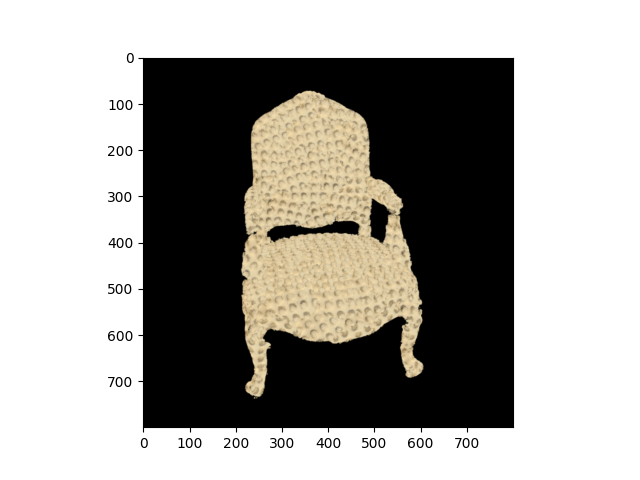

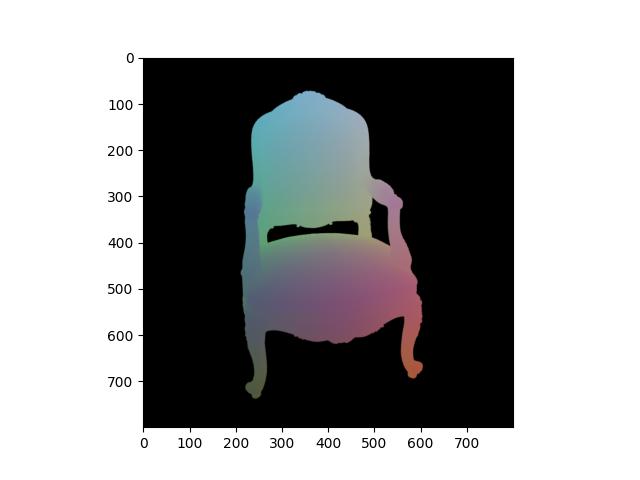

In [144]:


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth_cont.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()

In [145]:
import kornia
K = torch.eye(3)[None].to(device="cuda")
K = torch.tensor([[1111, 0, 400],
                  [0, 1111, 400],
                  [0, 0,    1  ]], dtype=torch.float32).unsqueeze(0).to(device="cuda")
normals = kornia.geometry.depth.depth_to_normals(depth=depth.unsqueeze(0).unsqueeze(0),
                                                 camera_matrix=K,
                                                 normalize_points=False)
image_normals = normals.squeeze(0)
mins = torch.amin(image_normals, dim=(0, 1, 2), keepdim=True)
maxs = torch.amax(image_normals, dim=(0, 1, 2), keepdim=True)
image_normals = (image_normals - mins) / (maxs - mins + 1e-6)

In [147]:
image_normals.shape

torch.Size([3, 800, 800])

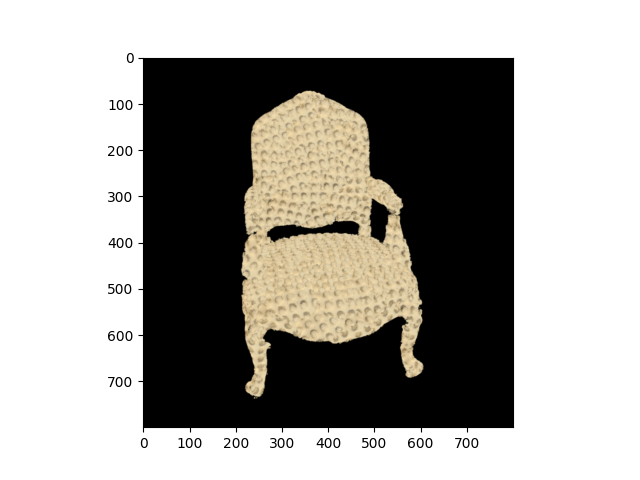

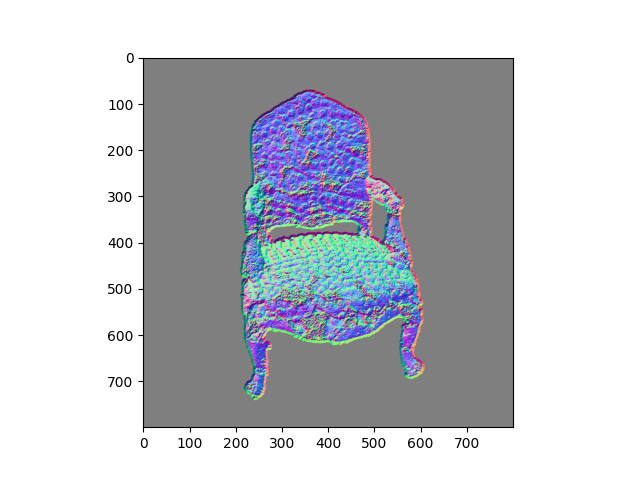

In [148]:
# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()

# Visualize
image_rgb = image_normals.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()

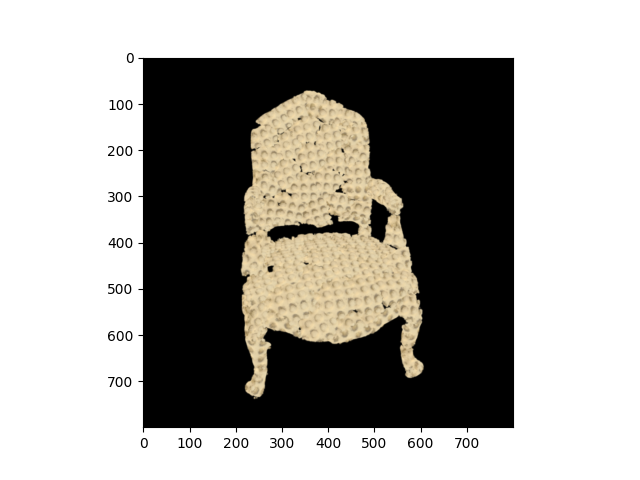

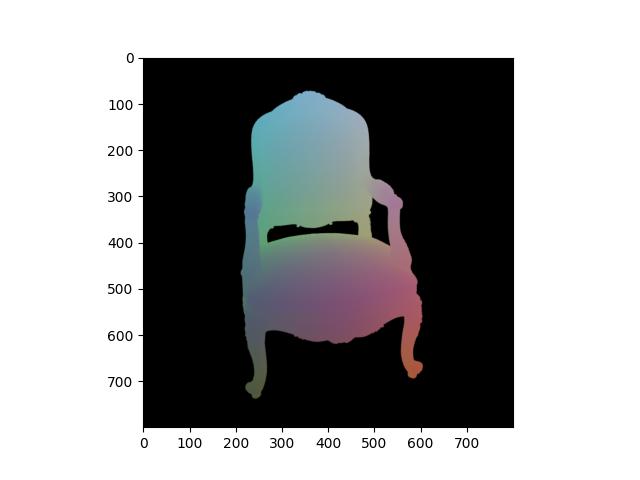

In [149]:


# Render
render_pkg = render(viewpoint_cam, gaussians_to_save, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]


# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()
image_rgb = image_cont.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()
# depth_np = depth_cont.detach().cpu().numpy()
# plt.figure()
# plt.imshow(depth_np)
# plt.colorbar()
# plt.show()

In [158]:
K = torch.tensor([[1111, 0, 400],
                  [0, 1111, 400],
                  [0, 0,    1  ]], dtype=torch.float32).unsqueeze(0).to(device="cuda")
normals = kornia.geometry.depth.depth_to_normals(depth=depth.unsqueeze(0).unsqueeze(0),
                                                 camera_matrix=K,
                                                 normalize_points=False)
image_normals = normals.squeeze(0)
mins = torch.amin(image_normals, dim=(0, 1, 2), keepdim=True)
maxs = torch.amax(image_normals, dim=(0, 1, 2), keepdim=True)
image_normals = (image_normals - mins) / (maxs - mins + 1e-6)

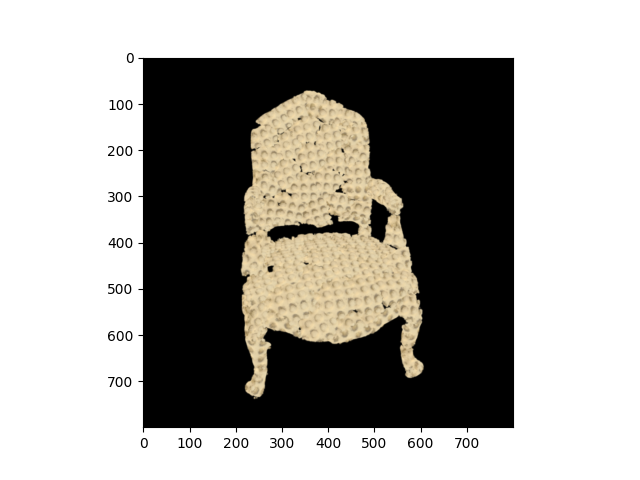

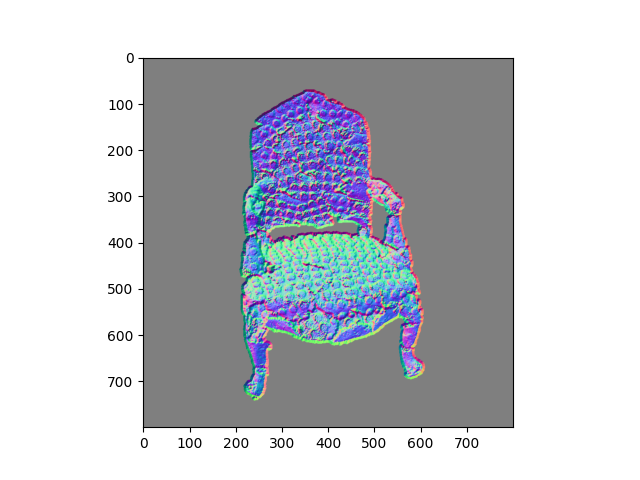

In [157]:
# Visualize
image_rgb = image.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()

# Visualize
image_rgb = image_normals.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_rgb)
plt.show()

In [286]:
depth.shape

torch.Size([800, 800])

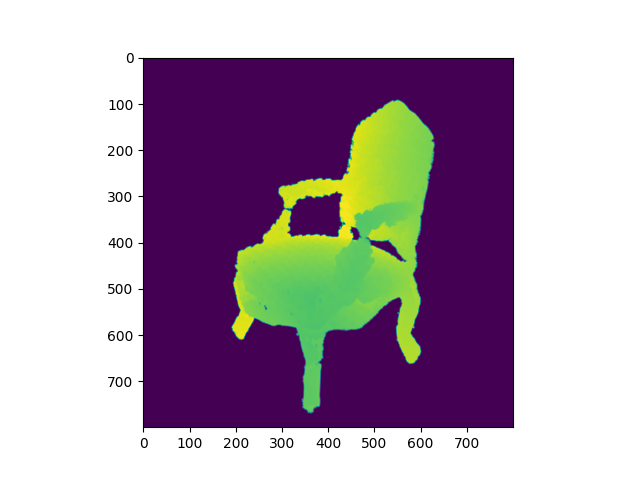

In [287]:
plt.figure()
plt.imshow(depth.detach().cpu().numpy())
plt.show()

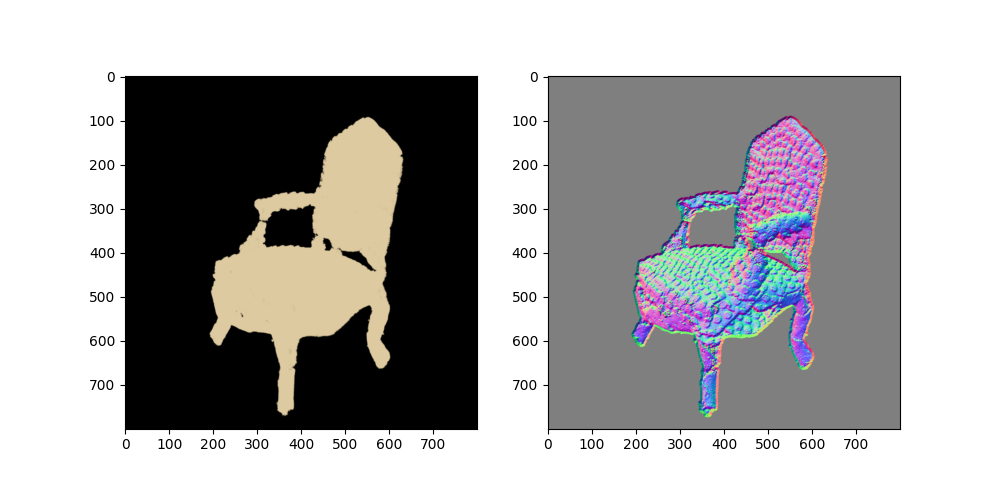

In [285]:
# Sample camera
# viewpoint_stack = scene_opt.getTrainCameras().copy()
# viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

# Compute normals
K = torch.tensor([[1111, 0, 400],
                  [0, 1111, 400],
                  [0, 0,    1  ]], dtype=torch.float32).unsqueeze(0).to(device="cuda")
normals = kornia.geometry.depth.depth_to_normals(depth=depth.unsqueeze(0).unsqueeze(0),
                                                 camera_matrix=K,
                                                 normalize_points=False)
image_normals = normals.squeeze(0)
mins = torch.amin(image_normals, dim=(0, 1, 2), keepdim=True)
maxs = torch.amax(image_normals, dim=(0, 1, 2), keepdim=True)
image_normals = (image_normals - mins) / (maxs - mins + 1e-6)


fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
ax[0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

In [ ]:
image_normals.detach().cpu().numpy()

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
ax[0].imshow(torch.linalg.norm(image_normals.detach().cpu().numpy().transpose(1, 2, 0), dim=-1))
ax[1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

In [257]:
(image_normals*torch.linalg.norm(image_cont, dim=-1, keepdims=True))

torch.Size([3, 800, 800])

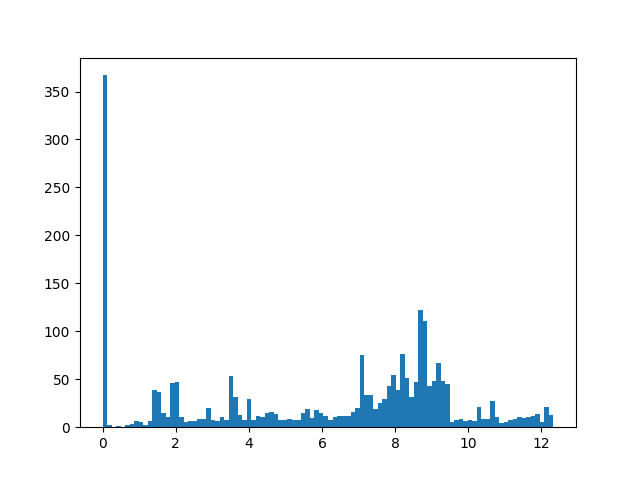

In [267]:
plt.figure()
plt.hist(torch.linalg.norm(image_cont, dim=-1, keepdims=True).detach().cpu().numpy().flatten(), bins=100)
plt.show()

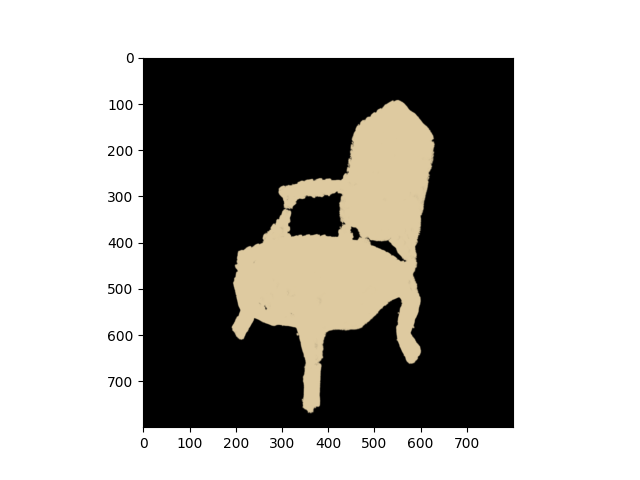

In [268]:
plt.figure()
plt.imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

In [271]:
torch.linalg.norm(image_normals, dim=0, keepdims=True).shape

torch.Size([1, 800, 800])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


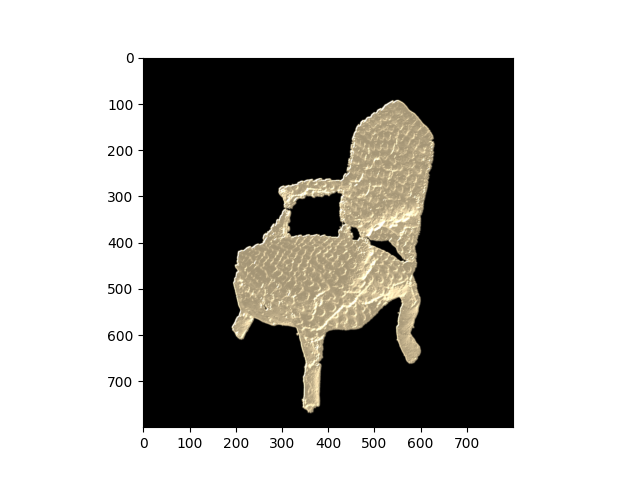

In [284]:
image_shaded_rgb = image*(1./(1e-6 + torch.linalg.norm(image_normals, dim=0, keepdims=True)))
image_shaded_rgb = image_shaded_rgb.detach().cpu().numpy().transpose(1, 2, 0)
plt.figure()
plt.imshow(image_shaded_rgb)
plt.show()

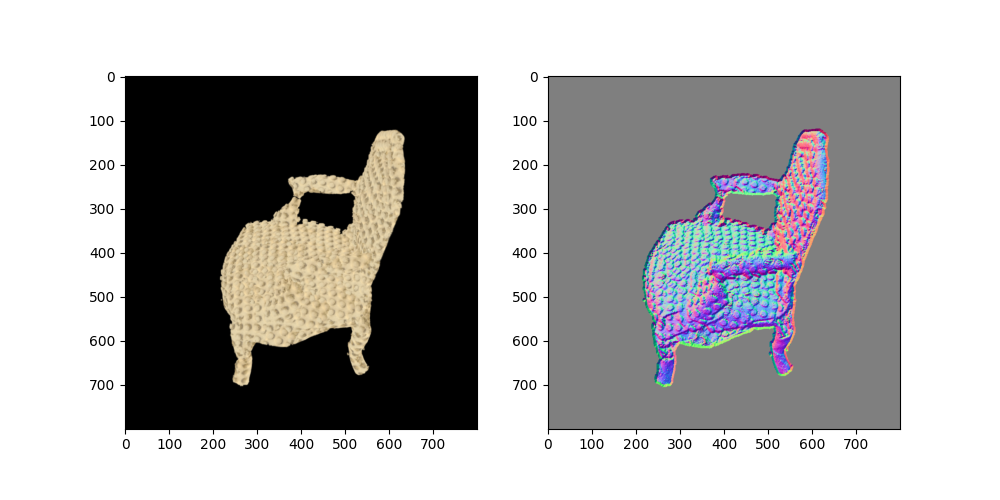

In [210]:
# Sample camera
viewpoint_stack = scene_opt.getTrainCameras().copy()
viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))


# Render
render_pkg = render(viewpoint_cam, gaussians_opt, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

# Compute normals
K = torch.tensor([[1111, 0, 400],
                  [0, 1111, 400],
                  [0, 0,    1  ]], dtype=torch.float32).unsqueeze(0).to(device="cuda")
normals = kornia.geometry.depth.depth_to_normals(depth=depth.unsqueeze(0).unsqueeze(0),
                                                 camera_matrix=K,
                                                 normalize_points=False)
image_normals = normals.squeeze(0)
mins = torch.amin(image_normals, dim=(0, 1, 2), keepdim=True)
maxs = torch.amax(image_normals, dim=(0, 1, 2), keepdim=True)
image_normals = (image_normals - mins) / (maxs - mins + 1e-6)


fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
ax[0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()

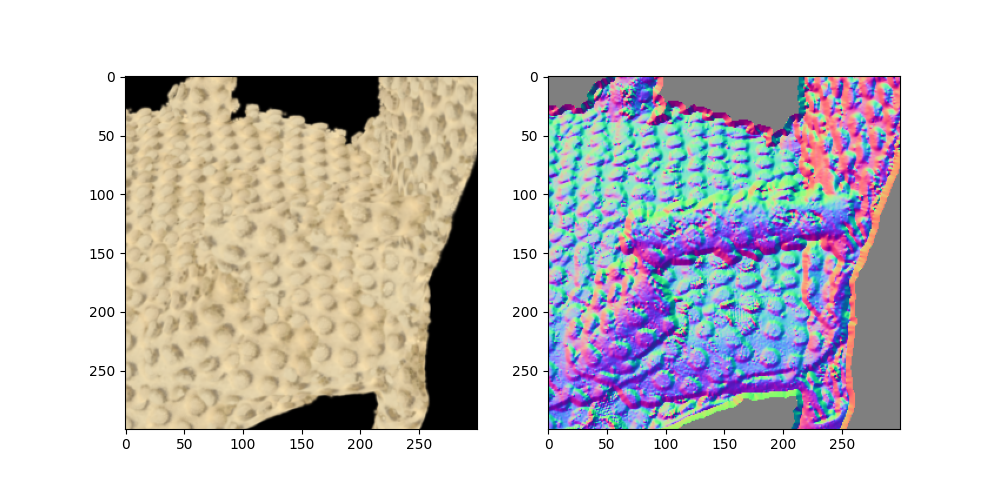

In [211]:

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
ax[0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0)[300:600,300:600])
ax[1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0)[300:600,300:600])
plt.show()

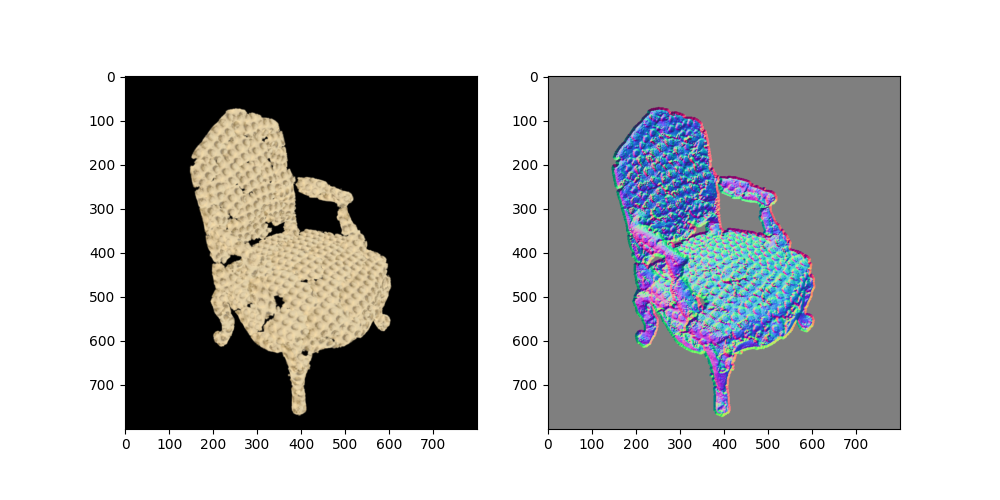

In [166]:
# Sample camera
# viewpoint_stack = scene_opt.getTrainCameras().copy()
# viewpoint_cam = viewpoint_stack.pop(randint(0, len(viewpoint_stack)-1))


# Render
render_pkg = render(viewpoint_cam, gaussians_to_save, pipe, background)
image, depth= render_pkg["render"], render_pkg["depth"]
render_pkg_cont = render(viewpoint_cam, content_gaussians, pipe, background)
image_cont, depth_cont= render_pkg_cont["render"], render_pkg_cont["depth"]

# Compute normals
K = torch.tensor([[1111, 0, 400],
                  [0, 1111, 400],
                  [0, 0,    1  ]], dtype=torch.float32).unsqueeze(0).to(device="cuda")
normals = kornia.geometry.depth.depth_to_normals(depth=depth.unsqueeze(0).unsqueeze(0),
                                                 camera_matrix=K,
                                                 normalize_points=False)
image_normals = normals.squeeze(0)
mins = torch.amin(image_normals, dim=(0, 1, 2), keepdim=True)
maxs = torch.amax(image_normals, dim=(0, 1, 2), keepdim=True)
image_normals = (image_normals - mins) / (maxs - mins + 1e-6)


fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10,5))
ax[0].imshow(image.detach().cpu().numpy().transpose(1, 2, 0))
ax[1].imshow(image_normals.detach().cpu().numpy().transpose(1, 2, 0))
plt.show()